In [ ]:
## 소분류[ 1-2), 2-1), 3-4), ...] Written by Dr. Jung-Hun Shin in Korea Institute of Science and Technology Information (KISTI)
import openai
import json
import fitz  # PyMuPDF
import os
import re
import shutil  # 파일 복사용
import requests
import time

# OpenAI API 키 설정 (본인의 API 키를 입력하거나 윈도우 시스템 환경변수 OPENAI_API_KEY를 설정)
OPENAI_API_KEY = os.getenv("OPENAI_API_KEY")
client = openai.OpenAI(api_key=OPENAI_API_KEY)  # 최신 방식

#  논문이 저장된 폴더 경로 (여기 수정) #Total20250404_withoutThesisSlide     추가20250225
PAPER_FOLDER_PATH = "D:\\2025\\Readables\\AeroAI\\Total20250530_withoutThesisSlide"  
OUTPUT_FOLDER = "Classified_Papers"  # 정리된 논문이 저장될 폴더
RESULT_JSON_PATH = "analysis_results_3rd.json"  # JSON 저장 경로
RESULT_TXT_PATH = "analysis_results_3rd.txt"  # TXT 저장 경로

#  논문 분류 기준 (15종)
classification_criteria = [
    "1) Compressible Flow Physics",
    "1-1) Compressible turbulence", "1-2) Shock waves", "1-3) Rarefied gas dynamics", "1-4) High-Mach-number flows",
    "1-5) Aeroacoustics in compressible flows", "1-6) Non-equilibrium effects",
    "2) Data-Driven Turbulence Modeling",
    "2-1) RANS/LES models", "2-2) Turbulence closures", "2-3) Turbulence structure identification",
    "2-4) Large-eddy simulation(LES) enhancement", "2-5) Improvement of RANS models: k-ε, k-ω, SA, et cetera",
    "2-6) Transfer learning for turbulence modeling", 
    "3) Shock & Boundary Layer Interaction (SBLI)",
    "3-1) Shock-induced separation", "3-2) Supersonic boundary layer dynamics",
    "3-3) Shock-turbulence interactions", "3-4) High-enthalpy effects on SBLI", "3-5) Machine learning for shock prediction",
    "4) Hypersonic Flow",
    "4-1) Hypersonic boundary layer transition", "4-2) High-speed flow stability", "4-3) Scramjet aerodynamics",
    "4-4) Rarefied flow effects in hypersonic regimes", "4-5) Hypersonic vehicle design optimization",
    "5) Reduced Order Modeling (ROM)",
    "5-1) Proper orthogonal decomposition (POD)", "5-2) Dynamic mode decomposition (DMD)", "5-3) Autoencoder-based ROM",
    "5-4) Nonlinear manifold learning", "5-5) Other ROM, Data-driven methods: Koopman, Genetic algorithm, support vector machin, et cetera", 
    "6) Vision, RNN, LLM based inference",
    "6-1) Computer vision for flow field analysis: Convolutional neural networks (CNN), et cetera",
    "6-2) Recurrent neural networks (RNNs) for unsteady flow prediction: Long short-term memory (LSTM) networks, et cetera",
    "6-3) Large language models (LLMs) for unsteady flows", "6-4) Generative adverarial networks (GANs) or Diffusion model for flow prediction", 
    "6-5) Reinforcement learning: RL, DRL", "6-6) Other deep learning methods – GRU, et cetera",
    "7) Scientific Machine Learning (SciML) & Physics-Informed Neural Networks (PINNs)",
    "7-1) Physics-informed neural networks (PINNs)", "7-2) Physics-Data hybrid modeling: fusion of physics based models and data based models", 
    "7-3) Neural differential equations for CFD: Neural operators, Universal differential equations (UDEs)",
    "7-4) Physics-constrained deep learning", 
    "8) Multi-Fidelity Modeling & Uncertainty Quantification (UQ)",
    "8-1) Multi-fidelity CFD modeling", "8-2) Bayesian deep learning for aerodynamics",
    "8-3) Regression based surrogate models: Probabilistic surrogate modeling, Gaussian process regression (GPR) for aerodynamics, et cetera",
    "8-4) Uncertainty quantification", 
    "9) Experimental Data Fusion",
    "9-1) Experimental and computational data fusion", "9-2) Sensor data-driven modeling",
    "9-3) Surrogate modeling for experiments", "9-4) Neural networks for experimental flow analysis",
    "10) Aerodynamic Design Optimization",
    "10-1) Machine learning for shape parameterization and optimization", "10-2) Adjoint-based optimization with Machine Learning",
    "10-3) Generative models for aerodynamic design", "10-4) Topology optimization in aerodynamics", "10-5) Inverse design using deep learning",  
    "10-6) Generative adversarial networks (GANs) for shape design", "10-7) Physics-informed inverse modeling", "10-8) Data-driven inverse problems in aerodynamics",
    "11) Machine Learning for Flow Control",
    "11-1) Reinforcement learning for active flow control: Machine learning-based jet actuation, Data-driven separation control, et cetera",
    "11-2) Deep reinforcement learning (DRL) for drag reduction", "11-3) Closed-loop control with neural networks",  
    "12) Multi-physics Applications",
    "12-1) Aero-elasticity", "12-2) Aero-thermodynamics", "12-3) Aero-thermoelasticity", "12-4) Aero-accoustics or aero-noise", 
    "12-5) Other multiphysics applications",
    "13) Review or survey papers"
]


#  PDF에서 Abstract 부분만 추출하는 함수
def extract_abstract_from_pdf(paper_file_path):
    """PDF 파일에서 Abstract(초록) 부분만 추출"""
    doc = fitz.open(paper_file_path)
    text = ""

    for page in doc:
        text += page.get_text("text") + "\n"

    # Abstract 찾기 (띄어쓰기 포함)
    abstract_match = re.search(r"(A\s*B\s*S\s*T\s*R\s*A\s*C\s*T|ABSTRACT|Abstract)\s*([\s\S]+?)(?=\n(Introduction|INTRODUCTION|Background|BACKGROUND|Nomenclature|1\.)|$)", text)

    if abstract_match:
        return abstract_match.group(2).strip()
    else:
        return "Abstract not found"

#  PDF에서 초기 300단어 추출하는 함수
def extract_first_300_words(paper_file_path):
    """PDF 파일에서 처음 300단어 추출"""
    doc = fitz.open(paper_file_path)
    text = ""

    # PDF의 모든 페이지에서 텍스트 추출
    for page in doc:
        text += page.get_text("text") + "\n"

    #print(text)

    # 공백 기준으로 단어 단위로 분할
    words = re.findall(r'\S+', text)  # 공백이 아닌 문자들(단어) 추출

    # 500단어까지만 가져와서 반환
    first_300_words = " ".join(words[:500])  # 500단어일 때 결과가 괜찮았음

    return first_300_words if first_300_words else "No text found"

#  ChatGPT에 보낼 프롬프트 생성
def generate_prompt(extract_text):
    return f"""
    논문의 내용을 분석하여 다음 정보를 한글로 제공해줘:

    1. **이 논문은 아래 60여종 분류 중 어느 카테고리에 속하는지 분류해줘(복수 가능). 분류번호를 2개 수준으로 부여했어. 예를 들어, 1-1)부터 1-6)까지는 상위 수준 분류번호인 "1) Compressible flow physics"의 하위 수준 분류번호들이야.**  
       **분류번호는 하위 수준 분류번호만 가지게 분류해줘. 예외적으로, 분류번호 13)은 하위 수준이 없으니 그냥 상위 수준 분류번호로 써줘. 즉, 상위 수준은 하위 수준 분류번호를 보면 아니까 상위 수준 분류번호는 "13) Review or survey papers"을 제외하고 꼭 빼야 된다.**
       **그리고, 분류할 때 되도록 Title, Abstract, Keywords라는 단어에 가까운 단어들이 해당 논문의 성격을 가장 많이 규정하기 때문에, 그 단어들을 더 중점적으로 감안해서 분류해줘. **
       **Introduction이라는 단어 이후에 나오는 단어들은 전반적인 동향과 관련되기 때문에 실제 논문과 관련없는 키워들이 많이 등장하니 무시하는게 나아.**
       **그래서, 논문의 파일명(혹은 title)과 Abstract, Keywords의 단어들과 내용들로 판단을 해주면 좋겠어." **
       {", ".join(classification_criteria)}
    2. **이 논문에서의 새로운 발견이나 성과는 무엇인가?**  

       **같은 논문은 항상 동일한 분류를 유지해야 하니 여러 번 분류해보고 가장 높은 확률의 분류번호들을 적어줘. 너의 판단이 매번 달라지는 경우가 많았어.**
       **각 논문별로 분류가 된 다음 상위 수준 분류번호가 여전히 들어가는 경우가 있는데, 13)을 제외하고 상위 수준 분류번호들이 안 나오게 다시 한 번 확인해줘.**
       **결과를 analysis_results.txt에 쓸 때 이모티콘은 안들어가게 해주면 좋겠어.**

    논문의 내용:
    {extract_text}

    결과 형식 예시:
    1. 분류번호: 1-2), 7-3), 11-1)
    2. 발견 혹은 성과: 
       - (...) 
       - (...)
    """

#  ChatGPT API 요청 함수
def ask_chatgpt(prompt):
    response = client.chat.completions.create(
        model="gpt-4.1",
        messages=[{"role": "system", "content": "You are PaperBot, an AI assistant for academic paper analysis."},
                  {"role": "user", "content": prompt}],
        temperature=0
    )
    return response.choices[0].message.content
    
''' # 폴더 생성 및 논문파일 복사는 일단 끔
# 안전한 폴더명 생성 함수 (한글 및 특수문자 제거)
def sanitize_folder_name(folder_name):
    """폴더명에서 한글 및 특수문자 제거"""
    folder_name = re.sub(r'[가-힣]', '', folder_name)  # 한글 제거
    folder_name = re.sub(r'[<>:"/\\|?*]', '', folder_name)  # Windows에서 문제되는 문자 제거
    folder_name = folder_name.strip()  # 앞뒤 공백 제거
    return folder_name[:100]  # 너무 길면 100자로 제한

# 안전한 파일명 생성 함수 (한글 및 특수문자 제거)
def sanitize_filename(filename):
    """파일명에서 한글 및 특수문자 제거 및 길이 제한"""
    filename = re.sub(r'[가-힣]', '', filename)  # 한글 제거
    filename = re.sub(r'[<>:"/\\|?*]', '', filename)  # Windows 문제 문자 제거
    filename = filename.strip()  # 앞뒤 공백 제거
    return filename[:145]  # 최대 길이 제한

def copy_to_classification_folders(paper_file_path, categories):
    """논문을 해당하는 모든 분류 폴더로 복사"""
    base_filename = sanitize_filename(os.path.basename(paper_file_path))  # 안전한 파일명으로 변경

    for category in categories:
        raw_folder_name = classification_criteria[int(category)-1].split(') ')[1].split(':')[0]
        folder_name = sanitize_folder_name(f"{category}) {raw_folder_name}")  # 폴더명 정리
        category_folder = os.path.join(OUTPUT_FOLDER, folder_name)
        os.makedirs(category_folder, exist_ok=True)  # 폴더 생성 (이미 있으면 생략)

        dest_file_path = os.path.join(category_folder, base_filename)  # 새로운 파일 경로
        shutil.copy(paper_file_path, dest_file_path)
        print(f" {paper_file_path} → {category_folder}에 복사 완료!")
'''

# ChatGPT 응답에서 분류번호 추출
def extract_categories_from_result(result_text):
    match = re.search(r"분류번호:\s*([\d, )]+)", result_text)
    if match:
        categories = re.findall(r"\d+", match.group(1))  
        return categories
    return []

#  폴더 내 모든 논문을 분석 및 분류
def extract_year_from_filename(filename):
    """파일 이름에서 (YYYY) 형식의 연도를 추출"""
    match = re.match(r"\(\s*([^\)]+)\)", filename)  # 괄호 안 내용 추출
    if match:
        content = match.group(1)
        digits = re.findall(r"\d{4}", content)       # 4자리 숫자만 찾기
        if digits:
            return digits[0]                         # 첫 번째 연도만 사용
    return "Unknown"

def extract_classification_and_analysis(result_text):
    """ChatGPT 응답에서 분류번호들과 분석 내용 추출"""


    # 1. 복합 분류번호 (예: 1-2), 3-2), 13)) 모두 인식
    classification_matches = re.findall(r"\b(\d{1,2}(?:-\d+)?\))", result_text)
    classification = classification_matches if classification_matches else ["Not found"]

    # 2. 분석 내용 추출
    analysis_match = re.search(r"발견 혹은 성과:\s*([\s\S]+?)(?:\n\d{1,2}(?:-\d+)?\)|\Z)", result_text)
    analysis = analysis_match.group(1).strip() if analysis_match else "Not found"

    return classification, analysis

def clean_title_from_filename(filename):
    """파일명에서 한글 및 특수문자 제거하고 제목 추정"""
    name = filename.replace(".pdf", "")
    # 괄호 안 숫자 제거 (연도)
    name = re.sub(r"\(\d{4}\)", "", name)
    # 한글 제거
    name = re.sub(r"[가-힣]", "", name)
    # 특수기호 제거
    name = re.sub(r"[^\w\s\-]", "", name)
    return name.strip()

def get_citation_count(title, retries=3, delay=2):
    url = "https://api.semanticscholar.org/graph/v1/paper/search"
    params = {
        "query": title,
        "fields": "title,citationCount",
        "limit": 1
    }
    for attempt in range(retries):
        try:
            response = requests.get(url, params=params)
            if response.status_code == 429:
                print("⚠️ 요청 속도가 너무 빠릅니다. 잠시 대기합니다...")
                time.sleep(delay * (attempt + 1))  # 지연 증가
                continue
            response.raise_for_status()
            results = response.json()
            if results.get("data"):
                return results["data"][0].get("citationCount", 0)
        except Exception as e:
            print(f" 인용 검색 오류 (시도 {attempt+1}/{retries}): {e}")
            time.sleep(delay)

    return 0

def analyze_all_papers():
    results_json = []
    results_txt = []

    print(f" 폴더 내 모든 논문을 분석합니다: {PAPER_FOLDER_PATH}\n")

    for filename in os.listdir(PAPER_FOLDER_PATH):
        if filename.endswith(".pdf"):
            file_path = os.path.join(PAPER_FOLDER_PATH, filename)
            print(f"\n 분석 중: {filename}")

            extract_text = extract_first_300_words(file_path)
            prompt = generate_prompt(extract_text)
            result = ask_chatgpt(prompt)

            print("\n 논문 분석 결과:")
            print(result)

            # 분류번호와 분석 내용 추출
            classification, analysis = extract_classification_and_analysis(result)

            # 파일명에서 연도 추출
            year = extract_year_from_filename(filename)

            # 인용횟수 추출
            citation_count = get_citation_count(clean_title_from_filename(filename))
            time.sleep(1.5)

            # ➕ 인용횟수 출력
            print(f"🔎 인용 횟수: {citation_count}")
            
            results_json.append({
                "filename": filename,
                "year": year,
                "classification": classification,
                "analysis": analysis,
                "citations": citation_count   #  인용 횟수 포함
            })

            # TXT 결과 저장
            results_txt.append(f"\n📄 논문: {filename} ({year})\n분류: {classification}\n{analysis}\n{'-'*80}\n")

    # JSON 파일 저장
    with open(RESULT_JSON_PATH, "w", encoding="utf-8") as f:
        json.dump(results_json, f, ensure_ascii=False, indent=4)

    # TXT 파일 저장
    with open(RESULT_TXT_PATH, "w", encoding="utf-8") as f:
        f.writelines(results_txt)

    print("\n 모든 논문 분석 완료!")
    print(f" 분석 결과 JSON 저장: {RESULT_JSON_PATH}")
    print(f" 분석 결과 TXT 저장: {RESULT_TXT_PATH}")

    print("\n 모든 논문 분석 완료!")
    print(f" 분석 결과 JSON 저장: {RESULT_JSON_PATH}")
    print(f" 분석 결과 TXT 저장: {RESULT_TXT_PATH}")

# 실행 (폴더 내 모든 논문 분석)
if __name__ == "__main__":
    analyze_all_papers()

📂 폴더 내 모든 논문을 분석합니다: D:\2025\Readables\AeroAI\Total20250530_withoutThesisSlide


📄 분석 중: (1993)Identification of aerodynamic coefficients using computational neural networks.pdf

📌 논문 분석 결과:
1. 분류번호: 9-4), 7-2)

2. 발견 혹은 성과:
   - 본 논문은 항공기 비행 데이터로부터 신경망(Neural Network)을 활용하여 공력 계수(aerodynamic coefficients)를 식별하는 새로운 방법을 제안하였다.
   - 각 공력 계수별로 개별 피드포워드 신경망을 구성하고, 신경망 가중치 추정 시 1차 편미분 정보를 활용하는 독창적인 방법을 도입하였다.
   - 기존의 다중 회귀나 최대우도추정(MLE) 기반 방법들이 제공하지 못했던, 전 비행영역에 걸쳐 매끄럽고 미분 가능한 공력 계수 모델을 생성할 수 있음을 시뮬레이션 데이터를 통해 입증하였다.
   - 제안된 방법은 온라인 학습 및 적응적, 비선형 제어에 적합한 공력 모델을 효과적으로 구축할 수 있음을 보였다.
⚠️ 요청 속도가 너무 빠릅니다. 잠시 대기합니다...
⚠️ 요청 속도가 너무 빠릅니다. 잠시 대기합니다...
🔎 인용 횟수: 180

📄 분석 중: (2003)Lift coefficient prediction at high angle of attack using recurrent neural network.pdf

📌 논문 분석 결과:
1. 분류번호: 6-2), 9-1)

2. 발견 혹은 성과:
   - 본 논문은 반복 신경망(Recurrent Neural Network, RNN)을 활용하여 고받음각(high angle of attack)에서의 로터 블레이드의 동적 실속(dynamic stall) 효과를 반영한 양력계수(CZ) 예측 방법을 제안하였다.
   - 실험적으로 얻어진 다양한 평균 받음각에서의 양력계수 데이터를 RNN에 

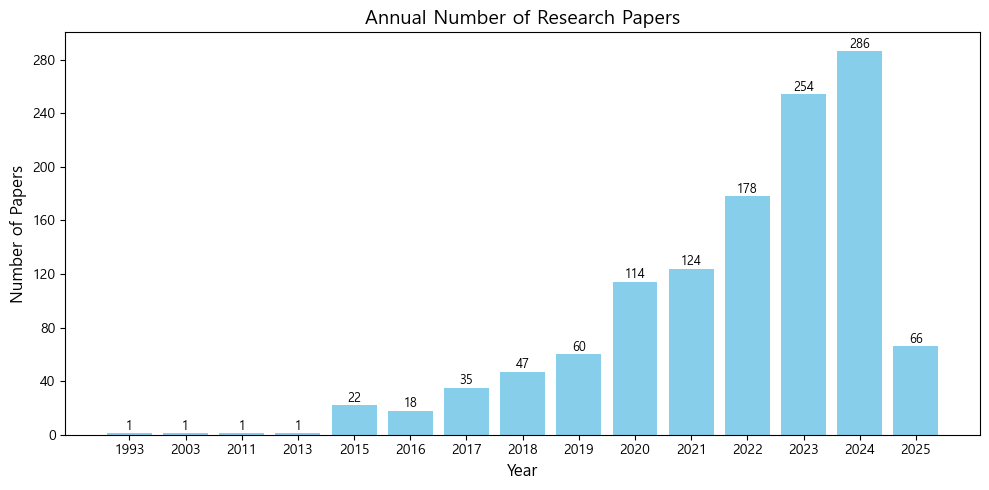

In [121]:
import json
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker

# 한글 폰트 설정 (Windows 기준)
plt.rcParams['font.family'] = 'Malgun Gothic'
plt.rcParams['axes.unicode_minus'] = False

# JSON 로드
with open("analysis_results_3rd.json", "r", encoding="utf-8") as f:
    data = json.load(f)

# 연도 추출 및 정제
years = [entry.get("year", "Unknown") for entry in data]
df = pd.DataFrame({"year": years})
df = df[df["year"] != "Unknown"]  # 'Unknown' 제외 (필요 시 포함 가능)

# 연도별 논문 수 집계
year_counts = df["year"].value_counts().sort_index()

# 히스토그램 그리기
plt.figure(figsize=(10, 5))
bars = plt.bar(year_counts.index, year_counts.values, color='skyblue')

# 막대 위에 수치 표시
for bar in bars:
    height = bar.get_height()
    plt.text(
        bar.get_x() + bar.get_width() / 2,
        height + 0.5,
        f"{int(height)}",
        ha='center',
        va='bottom',
        fontsize=9
    )

# 라벨 및 제목
plt.title("Annual Number of Research Papers", fontsize=14)
plt.xlabel("Year", fontsize=12)
plt.ylabel("Number of Papers", fontsize=12)
plt.gca().yaxis.set_major_locator(ticker.MaxNLocator(integer=True))  # y축 정수

plt.tight_layout()
plt.show()


C:\Users\KISTI\AppData\Local\Temp\ipykernel_31172\942196558.py:30: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.

C:\Users\KISTI\AppData\Local\Temp\ipykernel_31172\942196558.py:31: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.

C:\Users\KISTI\AppData\Local\Temp\ipykernel_31172\942196558.py:32: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



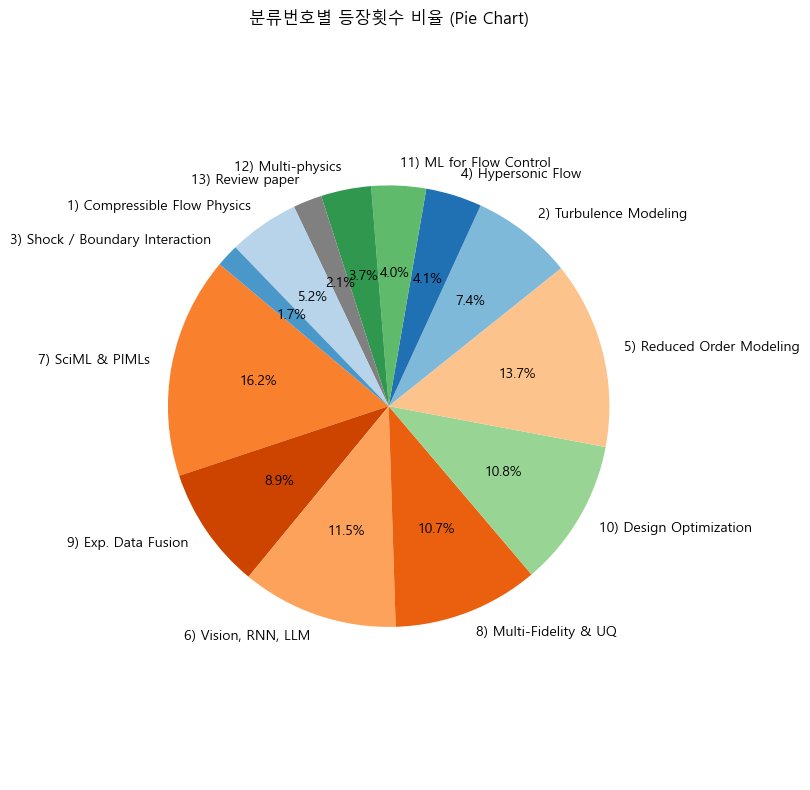

In [122]:
import json
import re
from collections import Counter
import matplotlib.pyplot as plt
from matplotlib.cm import get_cmap
from matplotlib.colors import to_hex

# 한글 폰트 설정 (Windows 기준)
plt.rcParams['font.family'] = 'Malgun Gothic'
plt.rcParams['axes.unicode_minus'] = False

# 대분류 번호와 이름 매핑
category_labels = {
    "1": "Compressible Flow Physics",
    "2": "Turbulence Modeling",
    "3": "Shock / Boundary Interaction",
    "4": "Hypersonic Flow",
    "5": "Reduced Order Modeling",
    "6": "Vision, RNN, LLM",
    "7": "SciML & PIMLs",
    "8": "Multi-Fidelity & UQ",
    "9": "Exp. Data Fusion",
    "10": "Design Optimization",
    "11": "ML for Flow Control",
    "12": "Multi-physics",
    "13": "Review paper"
}

# 색상 지정: 1~4은 Blues, 5~9는 Oranges, 10~12는 Greens
physics_colors = [to_hex(get_cmap('Blues')(0.3 + 0.15 * i)) for i in range(4)]
method_colors = [to_hex(get_cmap('Oranges')(0.3 + 0.12 * i)) for i in range(5)]
application_colors = [to_hex(get_cmap('Greens')(0.4 + 0.15 * i)) for i in range(3)]

# 통합 색상 매핑
category_colors = dict()
for i, k in enumerate(map(str, range(1, 5))):    # 1~4
    category_colors[k] = physics_colors[i]
for i, k in enumerate(map(str, range(5, 10))):   # 5~9
    category_colors[k] = method_colors[i]
for i, k in enumerate(map(str, range(10, 13))):  # 10~12
    category_colors[k] = application_colors[i]
category_colors["13"] = "gray"

# JSON 로드
with open("analysis_results_3rd.json", "r", encoding="utf-8") as f:
    data = json.load(f)

# 분류번호 집계
counter = Counter()
for entry in data:
    majors = set()
    for c in entry.get("classification", []):
        match = re.match(r"(\d{1,2})", c.strip())
        if match:
            major = match.group(1).lstrip("0")
            majors.add(major)
    for major in majors:
        if major in category_labels:
            counter[major] += 1


# 데이터 정리
labels = [f"{k}) {category_labels[k]}" for k in counter.keys()]
sizes = [counter[k] for k in counter.keys()]

# 파이차트 그리기
plt.figure(figsize=(8, 8))
plt.pie(sizes, labels=labels, colors=[category_colors[k] for k in counter.keys()],
        autopct='%1.1f%%', startangle=140)
plt.title("분류번호별 등장횟수 비율 (Pie Chart)")
plt.axis('equal')
plt.tight_layout()
plt.show()


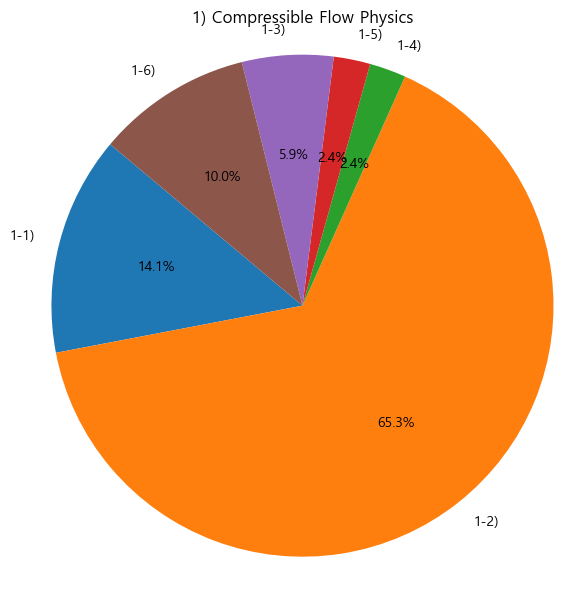

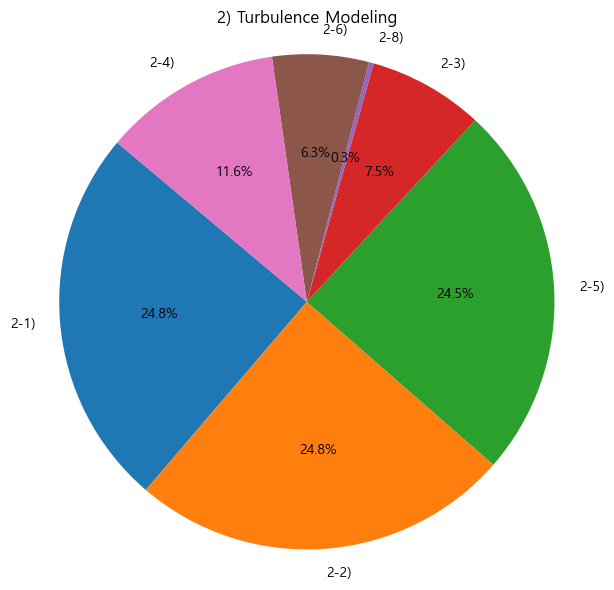

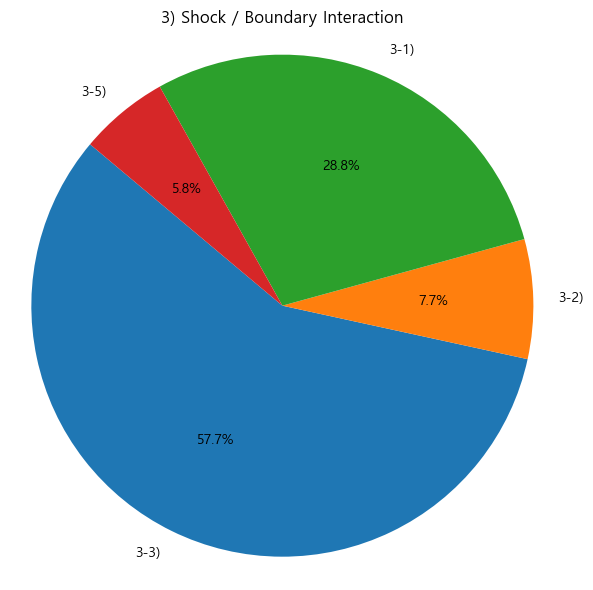

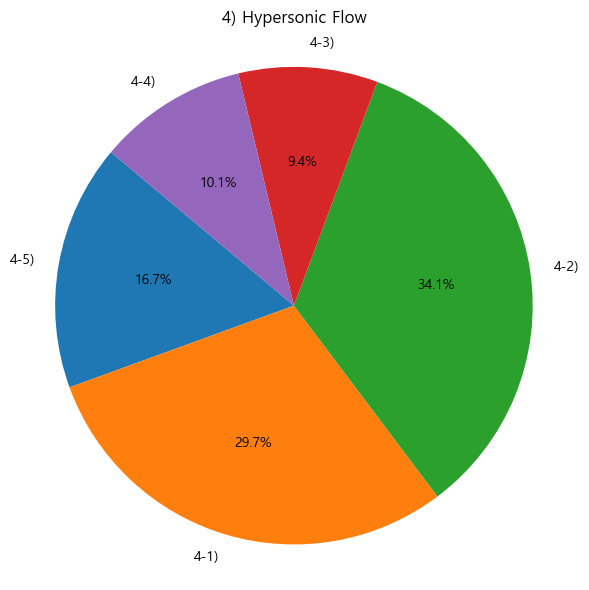

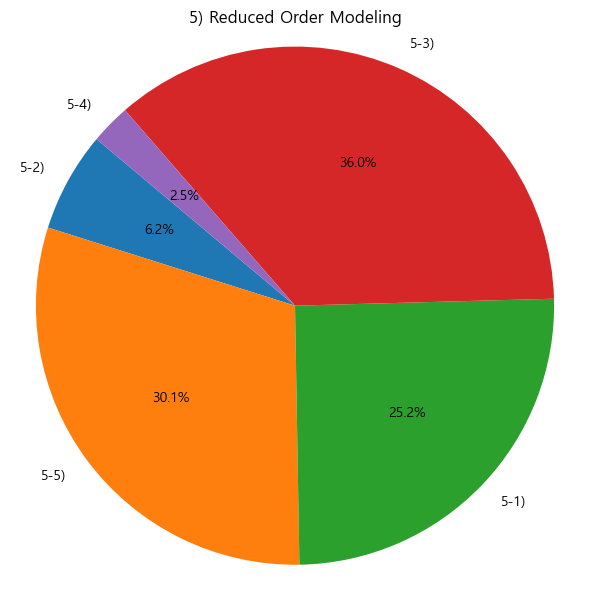

...

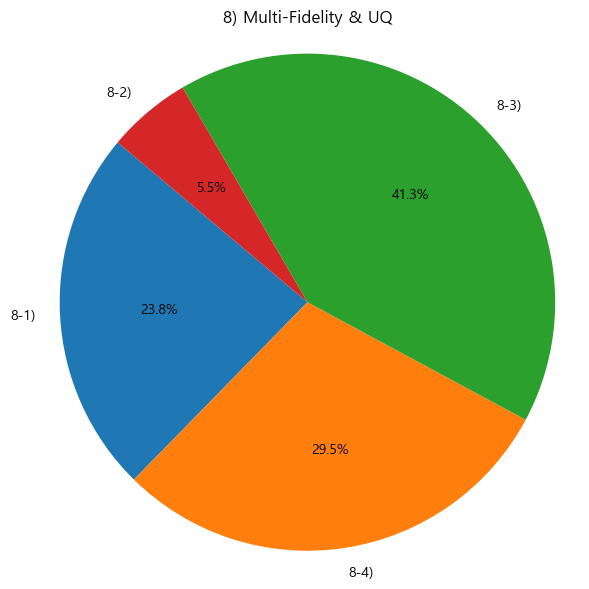

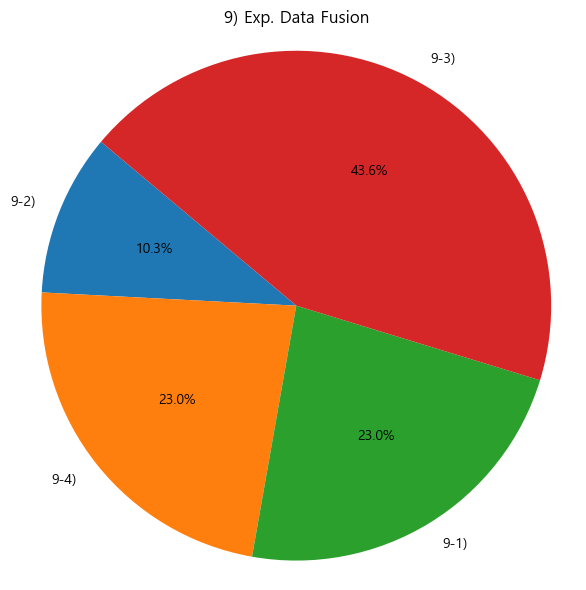

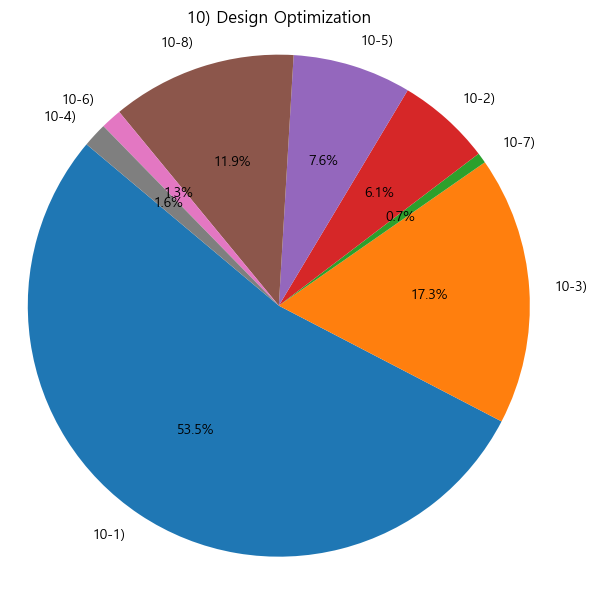

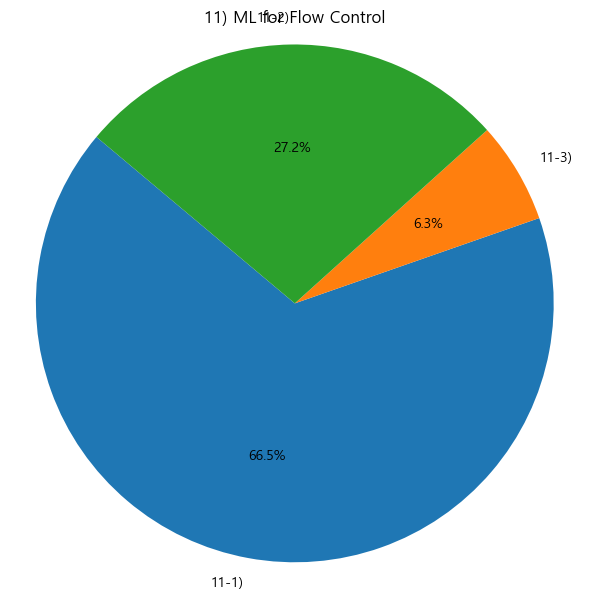

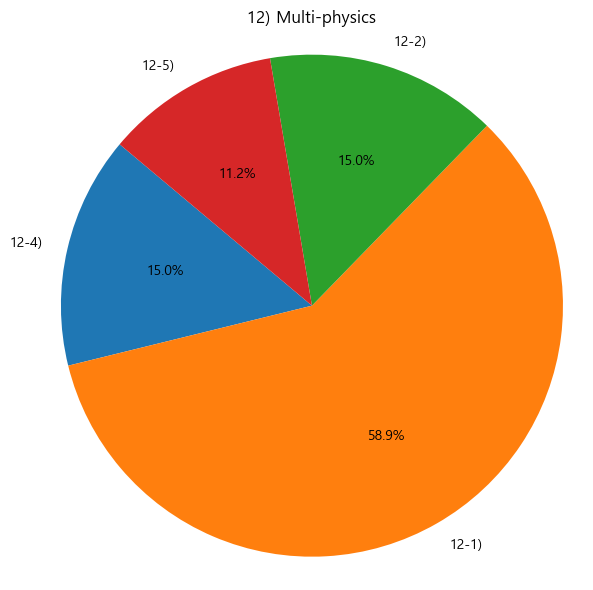

✅ Pie charts saved in: pie_charts_by_major


In [123]:
import json
import re
from collections import defaultdict, Counter
import matplotlib.pyplot as plt
import os

# 한글 폰트 설정 (Windows 사용자의 경우 필요)
plt.rcParams['font.family'] = 'Malgun Gothic'
plt.rcParams['axes.unicode_minus'] = False

# 대분류 번호와 이름 정의 (13번 Review paper 제외)
category_labels = {
    "1": "Compressible Flow Physics",
    "2": "Turbulence Modeling",
    "3": "Shock / Boundary Interaction",
    "4": "Hypersonic Flow",
    "5": "Reduced Order Modeling",
    "6": "Vision, RNN, LLM",
    "7": "SciML & PIMLs",
    "8": "Multi-Fidelity & UQ",
    "9": "Exp. Data Fusion",
    "10": "Design Optimization",
    "11": "ML for Flow Control",
    "12": "Multi-physics"
}

#  논문 분류 기준 (13종)
classification_criteria = [
    "1) Compressible Flow Physics",
    "1-1) Compressible turbulence", "1-2) Shock waves", "1-3) Rarefied gas dynamics", "1-4) High-Mach-number flows",
    "1-5) Aeroacoustics in compressible flows", "1-6) Non-equilibrium effects",
    "2) Data-Driven Turbulence Modeling",
    "2-1) RANS/LES models", "2-2) Turbulence closures", "2-3) Turbulence structure identification",
    "2-4) Large-eddy simulation (LES) enhancement", "2-5) Improvement of RANS models: k-ε, k-ω, SA, et cetera",
    "2-6) Transfer learning for turbulence modeling", 
    "3) Shock & Boundary Layer Interaction (SBLI)",
    "3-1) Shock-induced separation", "3-2) Supersonic boundary layer dynamics",
    "3-3) Shock-turbulence interactions", "3-4) High-enthalpy effects on SBLI", "3-5) Machine learning for shock prediction",
    "4) Hypersonic Flow",
    "4-1) Hypersonic boundary layer transition", "4-2) High-speed flow stability", "4-3) Scramjet aerodynamics",
    "4-4) Rarefied flow effects in hypersonic regimes", "4-5) Hypersonic vehicle design optimization",
    "5) Reduced Order Modeling (ROM)",
    "5-1) Proper orthogonal decomposition (POD)", "5-2) Dynamic mode decomposition (DMD)", "5-3) Autoencoder-based ROM",
    "5-4) Nonlinear manifold learning", "5-5) Other ROM, Data-driven methods", 
    "6) Vision, RNN, LLM based inference",
    "6-1) Computer vision for flow field analysis: Convolutional neural networks (CNN), et cetera",
    "6-2) Recurrent neural networks (RNNs) for unsteady flow prediction: Long short-term memory (LSTM) networks, et cetera",
    "6-3) Large language models (LLMs) for unsteady flows", "6-4) Generative adverarial networks (GANs) or Diffusion model for flow prediction", 
    "6-5) Other deep learning methods – GRU, et cetera",
    "7) Scientific Machine Learning (SciML) & Physics-Informed Machine Learning (PIML)",
    "7-1) Physics-informed neural networks (PINNs)", "7-2) Physics-Data hybrid modeling: fusion of physics based models and data based models", 
    "7-3) Neural differential equations for CFD: Neural operators, Universal differential equations (UDEs)",
    "7-4) Physics-constrained machine learning or deep learning", "7-5) Other Scientific machine learning, et cetera", 
    "8) Multi-Fidelity Modeling & Uncertainty Quantification (UQ)",
    "8-1) Multi-fidelity CFD modeling", "8-2) Bayesian deep learning for aerodynamics",
    "8-3) Regression based surrogate models: Probabilistic surrogate modeling, Gaussian process regression (GPR) for aerodynamics, et cetera",
    "8-4) Uncertainty quantification", 
    "9) Experimental Data Fusion",
    "9-1) Experimental and computational data fusion", "9-2) Sensor data-driven modeling",
    "9-3) Surrogate modeling for experiments", "9-4) Neural networks for experimental flow analysis",
    "10) Machine Learning for Flow Control",
    "10-1) Reinforcement learning for active flow control: Machine learning-based jet actuation, Data-driven separation control, et cetera",
    "10-2) Deep reinforcement learning (DRL) for drag reduction", "10-3) Closed-loop control with neural networks",
    "11) Aerodynamic Design Optimization",
    "11-1) Machine learning for shape parameterization and optimization", "11-2) Adjoint-based optimization with ML",
    "11-3) Generative models for aerodynamic design", "11-4) Topology optimization in aerodynamics", "11-5) Inverse design using deep learning",
    "11-6) Generative adversarial networks (GANs) for shape design", "11-7) Physics-informed inverse modeling", "11-8) Data-driven inverse problems in aerodynamics",
    "12) Multi-physics Applications",
    "12-1) Aero-elasticity", "12-2) Aero-thermodynamics", "12-3) Aero-thermoelasticity", "12-4) Aero-accoustics or aero-noise", 
    "12-5) Other multiphysics applications",
    "13) Review or survey papers"
]

# JSON 파일 로드
with open("analysis_results_3rd.json", "r", encoding="utf-8") as f:
    data = json.load(f)

# 대분류 → 소분류별 논문 수 카운트
subcategory_counts = defaultdict(Counter)

for entry in data:
    for c in entry.get("classification", []):
        match = re.match(r"(\d{1,2})-(\d{1,2})\)", c)
        if match:
            major, sub = match.groups()
            if major in category_labels:
                label = f"{major}-{sub})"
                subcategory_counts[major][label] += 1

# 저장 디렉토리 생성
output_dir = "pie_charts_by_major"
os.makedirs(output_dir, exist_ok=True)

# 각 대분류별로 파이차트 저장
for major in sorted(category_labels.keys(), key=int):
    sub_counter = subcategory_counts.get(major, {})
    if not sub_counter:
        continue  # 해당 대분류에 소분류 없으면 생략

    labels = list(sub_counter.keys())
    sizes = [sub_counter[k] for k in labels]

    plt.figure(figsize=(6, 6))
    plt.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=140)
    plt.title(f"{major}) {category_labels[major]}")
    plt.axis("equal")
    plt.tight_layout()
    plt.savefig(f"{output_dir}/major_{major}_pie_chart.png")
    plt.show()

print(f"✅ Pie charts saved in: {output_dir}")


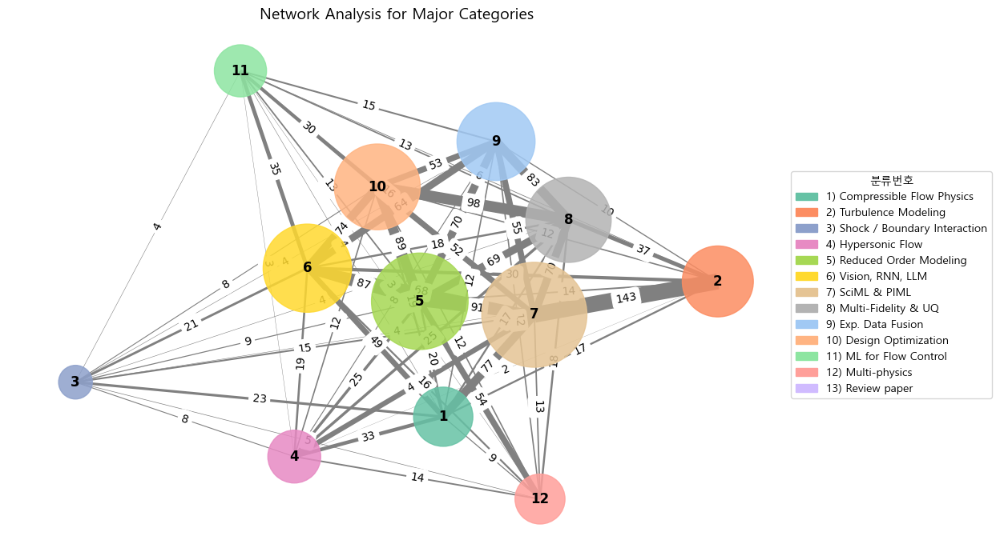

In [124]:
import json
import re
import networkx as nx
import matplotlib.pyplot as plt
from collections import Counter
from matplotlib.patches import Patch

# Windows용 한글 폰트 설정
plt.rcParams['font.family'] = 'Malgun Gothic'
plt.rcParams['axes.unicode_minus'] = False  # 마이너스 부호 깨짐 방지

# 대분류 번호와 이름 매핑
category_labels = {
    "1": "Compressible Flow Physics",
    "2": "Turbulence Modeling",
    "3": "Shock / Boundary Interaction",
    "4": "Hypersonic Flow",
    "5": "Reduced Order Modeling",
    "6": "Vision, RNN, LLM",
    "7": "SciML & PIML",
    "8": "Multi-Fidelity & UQ",
    "9": "Exp. Data Fusion",
    "10": "Design Optimization",
    "11": "ML for Flow Control",
    "12": "Multi-physics",
    "13": "Review paper"
}

category_colors = {
    "1": "#66c2a5",
    "2": "#fc8d62",
    "3": "#8da0cb",
    "4": "#e78ac3",
    "5": "#a6d854",
    "6": "#ffd92f",
    "7": "#e5c494",
    "8": "#b3b3b3",
    "9": "#a1c9f4",
    "10": "#ffb482",
    "11": "#8de5a1",
    "12": "#ff9f9a",
    "13": "#d0bbff"
}

# JSON 파일 로드 (또는 리스트 그대로 사용 가능)
with open("analysis_results_3rd.json", "r", encoding="utf-8") as f:
    papers = json.load(f)

# 논문별 대분류 추출 함수
def extract_major_categories(classifications):
    majors = set()
    for c in classifications:
        match = re.match(r"(\d{1,2})-", c)  # 예: "6-1)" → "6"
        if match:
            majors.add(match.group(1))
    return list(majors)

# 그래프 생성
G = nx.Graph()
edge_counter = Counter()
node_counter = Counter()  # 대분류 등장 횟수 저장용

# 범례용 컬러박스 생성 (모두 같은 색으로 단순 처리, 필요 시 분류별 색도 가능)
legend_handles = [
    Patch(color="skyblue", label=f"{key}) {label}")
    for key, label in category_labels.items() if key in G.nodes
]

# 논문마다 대분류 추출 후 연결
for paper in papers:
    majors = extract_major_categories(paper["classification"])
    # 노드 등장 횟수 세기
    for m in majors:
        node_counter[m] += 1
    # 분류 간 연결 만들기
    for i in range(len(majors)):
        for j in range(i + 1, len(majors)):
            pair = tuple(sorted([majors[i], majors[j]]))  # 순서 상관없게
            edge_counter[pair] += 1

# 노드 추가 (사이즈 정보 포함)
for node, count in node_counter.items():
    G.add_node(node, size=count)

# 노드 색상 리스트 생성
node_colors = [category_colors.get(n, "#cccccc") for n in G.nodes()]

# 엣지 추가
for (src, tgt), weight in edge_counter.items():
    G.add_edge(src, tgt, weight=weight)

# 그래프 시각화
pos = nx.spring_layout(G, seed=42, k=5.5, iterations=100)  #nx.kamada_kawai_layout(G)

# 노드 사이즈 계산 (예: 출현 횟수 × 300, 시각적으로 잘 보이게 조절)
node_sizes = [G.nodes[n]["size"] * 20 for n in G.nodes()]

plt.figure(figsize=(10, 7))
nx.draw_networkx_nodes(G, pos, node_size=node_sizes, node_color=node_colors, alpha=0.85)
nx.draw_networkx_edges(G, pos, width=[G[u][v]["weight"] / 10 for u, v in G.edges()], edge_color="gray")
nx.draw_networkx_labels(G, pos, font_size=12, font_weight="bold")

# 엣지에 연결 횟수 표시
edge_labels = nx.get_edge_attributes(G, 'weight')
nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels)

# 범례 생성 (전체 분류 포함)
legend_handles = [
    Patch(color=category_colors[key], label=f"{key}) {category_labels[key]}")
    for key in category_labels
]

plt.title("Network Analysis for Major Categories", fontsize=14)
plt.axis("off")
plt.tight_layout()
plt.legend(handles=legend_handles, title="분류번호", loc="center left", bbox_to_anchor=(1, 0.5))
plt.show()


C:\Users\KISTI\AppData\Local\Temp\ipykernel_31172\3356175299.py:28: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



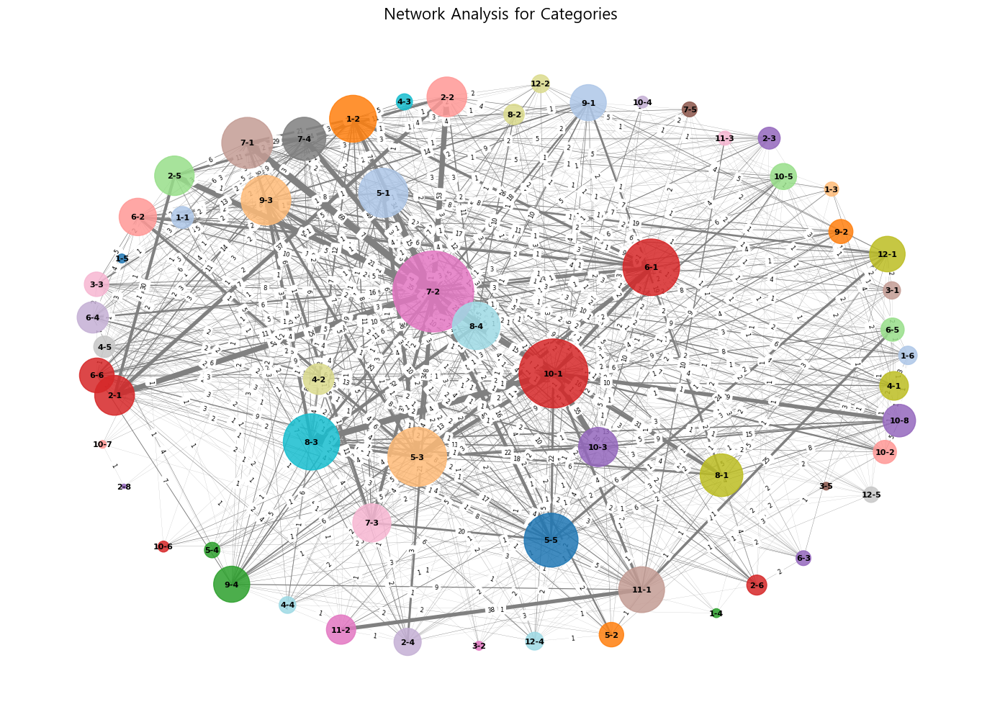

In [125]:
import json
import re
import networkx as nx
import matplotlib.pyplot as plt
from collections import Counter
from matplotlib.cm import get_cmap
from matplotlib.colors import to_hex
from matplotlib.patches import Patch

# 한글 폰트 설정 (Windows)
plt.rcParams['font.family'] = 'Malgun Gothic'
plt.rcParams['axes.unicode_minus'] = False

# JSON 파일 로드
with open("analysis_results_3rd.json", "r", encoding="utf-8") as f:
    papers = json.load(f)

# 소분류 추출 함수
def extract_sub_categories(classifications):
    subs = set()
    for c in classifications:
        match = re.match(r"(\d{1,2}-\d{1,2})\)", c)  # 예: "6-1)" → "6-1"
        if match:
            subs.add(match.group(1))
    return list(subs)

# 대분류 색상 팔레트 (tab20으로 분류당 5개씩 생성)
base_colors = get_cmap('tab20')
category_colors = {}
for i in range(12):  # 대분류 1~12
    for j in range(5):  # 소분류 개별 색
        key = f"{i+1}-{j+1}"
        category_colors[key] = to_hex(base_colors((i * 5 + j) % 20))

# 그래프 생성
G = nx.Graph()
edge_counter = Counter()
node_counter = Counter()

for paper in papers:
    subs = extract_sub_categories(paper.get("classification", []))
    for s in subs:
        node_counter[s] += 1
    for i in range(len(subs)):
        for j in range(i + 1, len(subs)):
            pair = tuple(sorted([subs[i], subs[j]]))
            edge_counter[pair] += 1

# 노드 추가
for node, count in node_counter.items():
    G.add_node(node, size=count)

# 엣지 추가
for (src, tgt), weight in edge_counter.items():
    G.add_edge(src, tgt, weight=weight)

# 노드 색상 설정
node_colors = []
for n in G.nodes():
    major = n.split("-")[0]
    offset = int(n.split("-")[1])
    color_key = f"{major}-{(offset % 5) + 1}"
    node_colors.append(category_colors.get(color_key, "#bbbbbb"))

# 노드 사이즈
node_sizes = [G.nodes[n]["size"] * 20 for n in G.nodes()]

# 그래프 시각화
pos = nx.spring_layout(G, seed=42, k=8, iterations=80)

plt.figure(figsize=(14, 10))
nx.draw_networkx_nodes(G, pos, node_size=node_sizes, node_color=node_colors, alpha=0.85)
nx.draw_networkx_edges(G, pos, width=[G[u][v]["weight"] / 10 for u, v in G.edges()], edge_color="gray")
nx.draw_networkx_labels(G, pos, font_size=8, font_weight="bold")

# 엣지 연결 횟수 작은 숫자로 표시
edge_labels = {e: f"{w}" for e, w in nx.get_edge_attributes(G, 'weight').items()}
nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels, font_size=6)

plt.title("Network Analysis for Categories", fontsize=16)
plt.axis("off")
plt.tight_layout()
plt.show()


C:\Users\KISTI\AppData\Local\Temp\ipykernel_33116\619870294.py:49: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  base_colors = get_cmap('tab10')


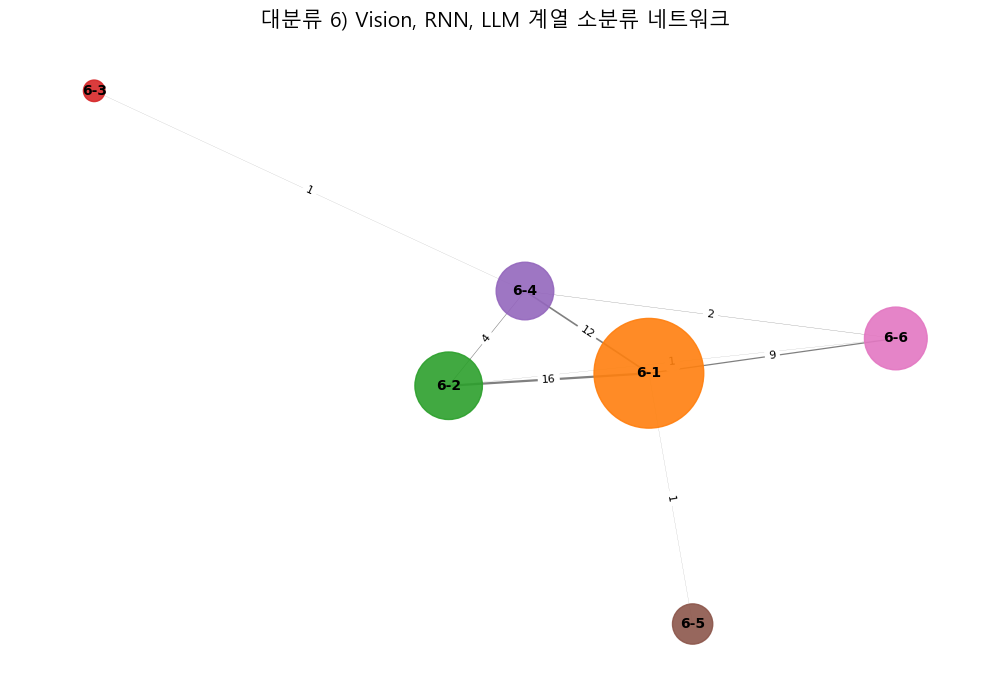

In [9]:
# 단일 대분류 내에서 중복 사용에 대한 분석 -> 크게 의미는 없으나 일단 스크립트 남겨둠.

import json
import re
import networkx as nx
import matplotlib.pyplot as plt
from collections import Counter
from matplotlib.cm import get_cmap
from matplotlib.colors import to_hex

# 한글 폰트 설정
plt.rcParams['font.family'] = 'Malgun Gothic'
plt.rcParams['axes.unicode_minus'] = False

# JSON 로드
with open("analysis_results_3rd.json", "r", encoding="utf-8") as f:
    papers = json.load(f)

# 🎯 대분류 6번에 해당하는 소분류만 추출
def extract_sub_categories_6(classifications):
    return [re.match(r"(6-\d{1,2})\)", c).group(1) for c in classifications
            if re.match(r"(6-\d{1,2})\)", c)]

# 네트워크 구성
G = nx.Graph()
edge_counter = Counter()
node_counter = Counter()

for paper in papers:
    subs = extract_sub_categories_6(paper.get("classification", []))
    if not subs:
        continue
    for s in subs:
        node_counter[s] += 1
    for i in range(len(subs)):
        for j in range(i + 1, len(subs)):
            pair = tuple(sorted([subs[i], subs[j]]))
            edge_counter[pair] += 1

# 노드 추가
for node, count in node_counter.items():
    G.add_node(node, size=count)

# 엣지 추가
for (src, tgt), weight in edge_counter.items():
    G.add_edge(src, tgt, weight=weight)

# 색상 구성 (tab10에서 파생)
base_colors = get_cmap('tab10')
node_colors = [to_hex(base_colors(int(n.split('-')[1]) % 10)) for n in G.nodes()]
node_sizes = [G.nodes[n]["size"] * 40 for n in G.nodes()]

# 시각화
pos = nx.spring_layout(G, seed=42, k=2.0, iterations=100)
plt.figure(figsize=(10, 7))
nx.draw_networkx_nodes(G, pos, node_size=node_sizes, node_color=node_colors, alpha=0.9)
nx.draw_networkx_edges(G, pos, width=[G[u][v]["weight"] / 10 for u, v in G.edges()], edge_color="gray")
nx.draw_networkx_labels(G, pos, font_size=10, font_weight="bold")

# 연결 횟수 라벨
edge_labels = {e: str(w) for e, w in nx.get_edge_attributes(G, 'weight').items()}
nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels, font_size=8)

plt.title("대분류 6) Vision, RNN, LLM 계열 소분류 네트워크", fontsize=15)
plt.axis("off")
plt.tight_layout()
plt.show()


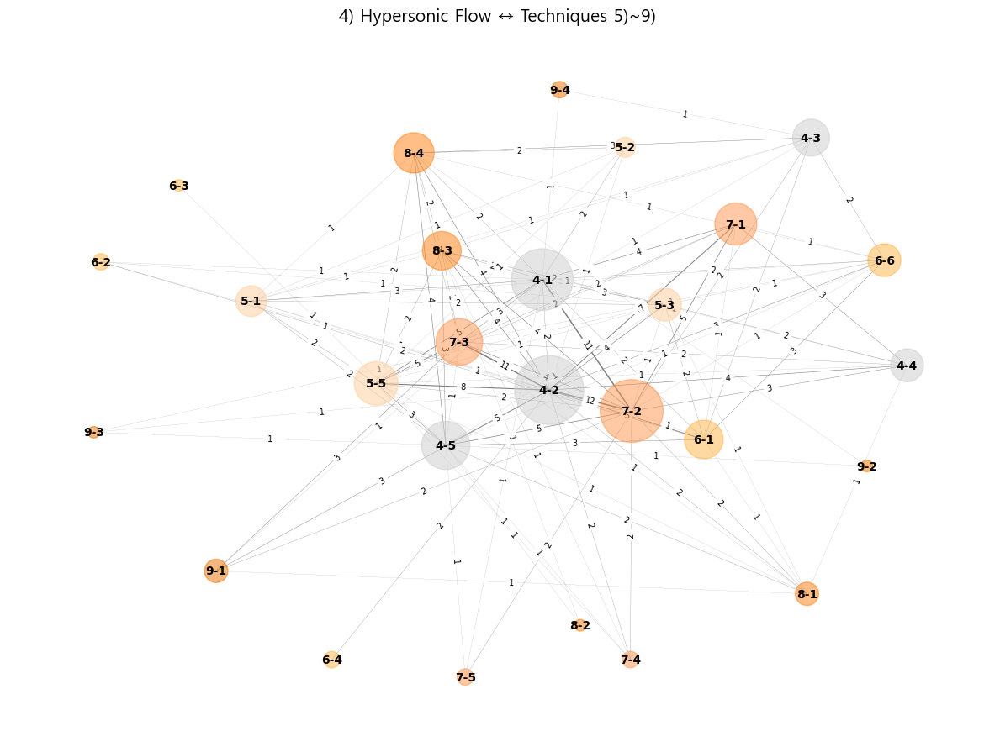

In [85]:
# Physics와 Application의 각 대분류에 대한 Method 5), 6), 7), 8), 9) 와의 네트워크 연결성 분석
import json
import re
import networkx as nx
import matplotlib.pyplot as plt
from collections import Counter
from matplotlib.cm import get_cmap
from matplotlib.colors import to_hex

# 폰트 설정
plt.rcParams['font.family'] = 'Malgun Gothic'
plt.rcParams['axes.unicode_minus'] = False

#  논문 분류 기준 (13종)
classification_criteria = [
    "1) Compressible Flow Physics",
    "1-1) Compressible turbulence", "1-2) Shock waves", "1-3) Rarefied gas dynamics", "1-4) High-Mach-number flows",
    "1-5) Aeroacoustics in compressible flows", "1-6) Non-equilibrium effects",
    "2) Data-Driven Turbulence Modeling",
    "2-1) RANS/LES models", "2-2) Turbulence closures", "2-3) Turbulence structure identification",
    "2-4) Large-eddy simulation(LES) enhancement", "2-5) Improvement of RANS models: k-ε, k-ω, SA, et cetera",
    "2-6) Transfer learning for turbulence modeling", 
    "3) Shock & Boundary Layer Interaction (SBLI)",
    "3-1) Shock-induced separation", "3-2) Supersonic boundary layer dynamics",
    "3-3) Shock-turbulence interactions", "3-4) High-enthalpy effects on SBLI", "3-5) Machine learning for shock prediction",
    "4) Hypersonic Flow",
    "4-1) Hypersonic boundary layer transition", "4-2) High-speed flow stability", "4-3) Scramjet aerodynamics",
    "4-4) Rarefied flow effects in hypersonic regimes", "4-5) Hypersonic vehicle design optimization",
    "5) Reduced Order Modeling (ROM)",
    "5-1) Proper orthogonal decomposition (POD)", "5-2) Dynamic mode decomposition (DMD)", "5-3) Autoencoder-based ROM",
    "5-4) Nonlinear manifold learning", "5-5) Other ROM, Data-driven methods: Koopman, Genetic algorithm, support vector machin, et cetera", 
    "6) Vision, RNN, LLM based inference",
    "6-1) Computer vision for flow field analysis: Convolutional neural networks (CNN), et cetera",
    "6-2) Recurrent neural networks (RNNs) for unsteady flow prediction: Long short-term memory (LSTM) networks, et cetera",
    "6-3) Large language models (LLMs) for unsteady flows", "6-4) Generative adverarial networks (GANs) or Diffusion model for flow prediction", 
    "6-5) Reinforcement learning: RL, DRL", "6-6) Other deep learning methods – GRU, et cetera",
    "7) Scientific Machine Learning (SciML) & Physics-Informed Machine Learning (PIML)",
    "7-1) Physics-informed neural networks (PINNs)", "7-2) Physics-Data hybrid modeling: fusion of physics based models and data based models", 
    "7-3) Neural differential equations for CFD: Neural operators, Universal differential equations (UDEs)",
    "7-4) Physics-constrained machine learning or deep learning", "7-5) Other Scientific machine learning, et cetera", 
    "8) Multi-Fidelity Modeling & Uncertainty Quantification (UQ)",
    "8-1) Multi-fidelity CFD modeling", "8-2) Bayesian deep learning for aerodynamics",
    "8-3) Regression based surrogate models: Probabilistic surrogate modeling, Gaussian process regression (GPR) for aerodynamics, et cetera",
    "8-4) Uncertainty quantification", 
    "9) Experimental Data Fusion",
    "9-1) Experimental and computational data fusion", "9-2) Sensor data-driven modeling",
    "9-3) Surrogate modeling for experiments", "9-4) Neural networks for experimental flow analysis",
    "10) Aerodynamic Design Optimization",
    "10-1) Machine learning for shape parameterization and optimization", "10-2) Adjoint-based optimization with Machine Learning",
    "10-3) Generative models for aerodynamic design", "10-4) Topology optimization in aerodynamics", "10-5) Inverse design using deep learning",  
    "10-6) Generative adversarial networks (GANs) for shape design", "10-7) Physics-informed inverse modeling", "10-8) Data-driven inverse problems in aerodynamics",
    "11) Machine Learning for Flow Control",
    "11-1) Reinforcement learning for active flow control: Machine learning-based jet actuation, Data-driven separation control, et cetera",
    "11-2) Deep reinforcement learning (DRL) for drag reduction", "11-3) Closed-loop control with neural networks",  
    "12) Multi-physics Applications",
    "12-1) Aero-elasticity", "12-2) Aero-thermodynamics", "12-3) Aero-thermoelasticity", "12-4) Aero-accoustics or aero-noise", 
    "12-5) Other multiphysics applications",
    "13) Review or survey papers"
]

# JSON 로드
with open("analysis_results_3rd.json", "r", encoding="utf-8") as f:
    papers = json.load(f)

# 계열 정의
physics_prefix = "4-"
method_prefixes = {"5-", "6-", "7-", "8-", "9-"}

# 논문에서 필요한 소분류 추출
def extract_subcategories_by_prefix(classifications, prefixes):
    return [re.match(rf"({'|'.join(prefixes)})\d{{1,2}}\)", c).group(0)[:-1]
            for c in classifications
            if re.match(rf"({'|'.join(prefixes)})\d{{1,2}}\)", c)]

# 네트워크 구성
G = nx.Graph()
edge_counter = Counter()
node_counter = Counter()

for paper in papers:
    classifications = paper.get("classification", [])
    physics_subs = extract_subcategories_by_prefix(classifications, {physics_prefix})
    method_subs = extract_subcategories_by_prefix(classifications, method_prefixes)

    if not physics_subs or not method_subs:
        continue  # 둘 다 있어야 포함

    subs = physics_subs + method_subs

    for s in subs:
        node_counter[s] += 1
    for i in range(len(subs)):
        for j in range(i + 1, len(subs)):
            pair = tuple(sorted([subs[i], subs[j]]))
            edge_counter[pair] += 1

# 노드 추가
for node, count in node_counter.items():
    G.add_node(node, size=count)

# 엣지 추가
for (src, tgt), weight in edge_counter.items():
    G.add_edge(src, tgt, weight=weight)

# 노드 색상 설정
def assign_color(n):
    major = n.split("-")[0]
    if major == "1":
        return "#1f77b4"  # 파랑: Physics
    elif major == "5":
        return "#ffcc99"
    elif major == "6":
        return "#ffb347"
    elif major == "7":
        return "#ff944d"
    elif major == "8":
        return "#ff7f0e"
    elif major == "9":
        return "#e67300"
    else:
        return "#cccccc"

node_colors = [assign_color(n) for n in G.nodes()]
node_sizes = [G.nodes[n]["size"] * 100 for n in G.nodes()]

# 시각화
pos = nx.spring_layout(G, seed=22, k=2.5)
plt.figure(figsize=(12, 9))
nx.draw_networkx_nodes(G, pos, node_size=node_sizes, node_color=node_colors, alpha=0.5)
nx.draw_networkx_edges(G, pos, width=[G[u][v]['weight'] / 10 for u, v in G.edges()], edge_color="gray")
nx.draw_networkx_labels(G, pos, font_size=10, font_weight="bold")

edge_labels = {e: str(w) for e, w in nx.get_edge_attributes(G, 'weight').items()}
nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels, font_size=7)

#plt.title("1) Compressible Flow Physics ↔ Techniques 5)~9)", fontsize=15)
#plt.title("2) Data-Driven Turbulence Modeling ↔ Techniques 5)~9) ", fontsize=15)
#plt.title("3) Shock & Boundary Layer Interaction (SBLI) ↔ Techniques 5)~9) ", fontsize=15)
plt.title("4) Hypersonic Flow ↔ Techniques 5)~9) ", fontsize=15)
#plt.title("10) Aerodynamic Design Optimization ↔ Techniques 5)~9) ", fontsize=15)
#plt.title("11) Machine Learning for Flow Control ↔ Techniques 5)~9) ", fontsize=15)
#plt.title("12) Multi-physics Applications ↔ Techniques 5)~9) ", fontsize=15)

plt.axis("off")
plt.tight_layout()
plt.show()


In [12]:
from pyvis.network import Network

# pyvis 네트워크 생성
net = Network(notebook=True, height="700px", width="100%", bgcolor="#222222", font_color="white")

# 노드 추가 (출현 빈도 기반 크기 반영)
for node in G.nodes():
    count = G.nodes[node].get("size", 1)  # 등장 횟수, 없으면 기본 1
    size = 10 + count * 3  # 기본 사이즈 10, 등장 횟수에 따라 가중치 조절
    net.add_node(node, label=f"분류 {node}", title=f"대분류 {node}, 등장 횟수: {count}", size=size)

# 엣지 추가 (공동 등장 논문 수 기반 굵기)
for (u, v), w in edge_counter.items():
    net.add_edge(u, v, value=w, title=f"{w} 논문에서 함께 등장")

# 결과 출력 (HTML로)
net.show("classification_network.html")

classification_network.html


In [86]:
import json
import pandas as pd
import numpy as np
import re
from itertools import combinations
import plotly.graph_objects as go

# Load JSON
with open("analysis_results_3rd.json", "r", encoding="utf-8") as f:
    data = json.load(f)

# 대분류 번호와 이름 매핑
category_labels = {
    "1": "Compressible Flow Physics",
    "2": "Turbulence Modeling",
    "3": "Shock / Boundary Interaction",
    "4": "Hypersonic Flow",
    "5": "Reduced Order Modeling",
    "6": "Vision, RNN, LLM",
    "7": "SciML & PIML",
    "8": "Multi-Fidelity & UQ",
    "9": "Exp. Data Fusion",
    "10": "Design Optimization",
    "11": "ML for Flow Control",
    "12": "Multi-physics",
    "13": "Review paper"
}

category_colors = {
    "1": "#66c2a5",
    "2": "#fc8d62",
    "3": "#8da0cb",
    "4": "#e78ac3",
    "5": "#a6d854",
    "6": "#ffd92f",
    "7": "#e5c494",
    "8": "#b3b3b3",
    "9": "#a1c9f4",
    "10": "#ffb482",
    "11": "#8de5a1",
    "12": "#ff9f9a",
    "13": "#d0bbff"
}

categories = list(category_labels.keys())
matrix = pd.DataFrame(0, index=categories, columns=categories)

def extract_majors(classifications):
    majors = set()
    for c in classifications:
        match = re.match(r"(\d{1,2})-", c)
        if match:
            major = match.group(1)
            if major in category_labels:
                majors.add(major)
        elif re.match(r"(\d{1,2})\)", c):
            major = re.match(r"(\d{1,2})\)", c).group(1)
            if major in category_labels:
                majors.add(major)
    return list(majors)

# 연결 매트릭스 채우기
for entry in data:
    majors = extract_majors(entry["classification"])
    for a, b in combinations(sorted(majors), 2):
        matrix.at[a, b] += 1
        matrix.at[b, a] += 1
    for m in majors:
        matrix.at[m, m] += 1

# 노드 정보
labels = [f"{k}) {category_labels[k]}" for k in categories]
colors = [category_colors[k] for k in categories]

source = []
target = []
value = []

for i, a in enumerate(categories):
    for j, b in enumerate(categories):
        if i < j and matrix.at[a, b] > 0:
            source.append(i)
            target.append(j)
            value.append(matrix.at[a, b])

# ✅ dummy 노드 추가
dummy_index = len(labels)
dummy_label = ""  # 라벨 숨김
dummy_color = "rgba(0,0,0,0)"  # 완전 투명
dummy_value = sum(value) * 2   # 전체 값보다 크게

# dummy 링크 (self-loop)
source.append(dummy_index)
target.append(dummy_index)
value.append(dummy_value)

labels.append(dummy_label)
colors.append(dummy_color)

# 링크 색상 (마지막 dummy만 투명)
link_colors = ["rgba(200,200,200,0.5)"] * (len(value) - 1) + ["rgba(0,0,0,0)"]

# Sankey 다이어그램 생성
fig = go.Figure(data=[go.Sankey(
    arrangement="snap",
    node=dict(
        pad=10,
        thickness=20,
        line=dict(color="black", width=0.5),
        label=labels,
        color=colors
    ),
    link=dict(
        source=source,
        target=target,
        value=value,
        color=link_colors
    )
)])

fig.update_layout(
    title_text="Network Analysis for Major Categories",
    font_size=12,
    height=1000,
    hovermode='x',
    dragmode='pan'
)

fig.show()


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
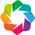

:Chord   [source,target]   (value,width,edge_color_col)

In [87]:
import json
import re
import pandas as pd
import holoviews as hv
from holoviews import opts
from collections import Counter

hv.extension('bokeh')

# 대분류 정의
category_labels = {
    "1": "Compressible Flow Physics",
    "2": "Turbulence Modeling",
    "3": "Shock / Boundary Interaction",
    "4": "Hypersonic Flow",
    "5": "Reduced Order Modeling",
    "6": "Vision, RNN, LLM",
    "7": "SciML & PIML",
    "8": "Multi-Fidelity & UQ",
    "9": "Exp. Data Fusion",
    "10": "Design Optimization",
    "11": "ML for Flow Control",
    "12": "Multi-physics",
    "13": "Review paper"
}

node_colors = [
    '#08519c', '#3182bd', '#6baed6', '#bdd7e7',       # physics (1~4)
    '#a50f15', '#de2d26', '#fb6a4a', '#fcae91', '#fee5d9',  # methods (5~9)
    '#31a354', '#a1d99b', '#e5f5e0',                   # application (10~12)
    '#969696'                                          # review (13)
]

# 주제별 그룹 (논리적 그룹)
physics_ids = [1, 2, 3, 4]
methods_ids = [5, 6, 7, 8, 9]
application_ids = [10, 11, 12]
review_ids = [13]

valid_major_ids = set(int(k) for k in category_labels)

# JSON 로드
with open("analysis_results_3rd.json", "r", encoding="utf-8") as f:
    papers = json.load(f)

# 대분류 추출
def extract_majors(classifications):
    majors = set()
    for c in classifications:
        match = re.match(r"^(\d{1,2})(?:-\d+)?\)$", c)
        if match:
            major = int(match.group(1))
            if major in valid_major_ids:
                majors.add(major)
    return list(majors)

# 엣지 및 노드 카운팅
edge_counter = Counter()
node_counter = Counter()

for paper in papers:
    majors = extract_majors(paper["classification"])
    for i in range(len(majors)):
        for j in range(i + 1, len(majors)):
            pair = tuple(sorted([majors[i], majors[j]]))
            edge_counter[pair] += 1
    for m in majors:
        node_counter[m] += 1

# 노드 ID 매핑 (0부터 시작)
node_ids = sorted(valid_major_ids)
id_map = {old_id: new_id for new_id, old_id in enumerate(node_ids)}
reverse_id_map = {v: k for k, v in id_map.items()}

# 엣지 색상 지정 조건
highlight_sources = set(physics_ids + application_ids + review_ids)
highlight_targets = set(methods_ids)

# 엣지 생성 및 색상 계산
edges = []
edge_colors = []

for (source, target), value in edge_counter.items():
    if source in id_map and target in id_map:
        s = id_map[source]
        t = id_map[target]
        edges.append((s, t, value))

        orig_s = source
        orig_t = target

        # 조건에 따른 엣지 색상
        if orig_s in highlight_sources and orig_t in highlight_targets:
            color = node_colors[id_map[orig_t]]  # target 색상
        else:
            color = node_colors[id_map[orig_s]]  # source 색상
        edge_colors.append(color)

# 엣지 DataFrame
edges_df = pd.DataFrame(edges, columns=["source", "target", "value"])
edges_df["width"] = edges_df["value"] / 15
edges_df["edge_color_col"] = edge_colors

# 노드 DataFrame
nodes_df = pd.DataFrame({
    'index': list(id_map.values()),
    'name': [category_labels[str(reverse_id_map[i])] for i in id_map.values()],
    'size': [node_counter.get(reverse_id_map[i], 1) for i in id_map.values()]
})

# Chord 생성
chord = hv.Chord((edges_df, hv.Dataset(nodes_df, kdims="index", vdims=["name", "size"])))

chord.opts(
    opts.Chord(
        labels='name',
        node_color='index',           # node_colors에 index 매핑
        edge_color='edge_color_col',  # 직접 지정된 색상 문자열 사용
        edge_line_width='width',
        cmap=node_colors,
        edge_alpha=0.8,
        label_text_font_size='10pt',
        width=850,
        height=850,
        title="Network Analysis for Major Categories - Chord Diagram"
    )
)



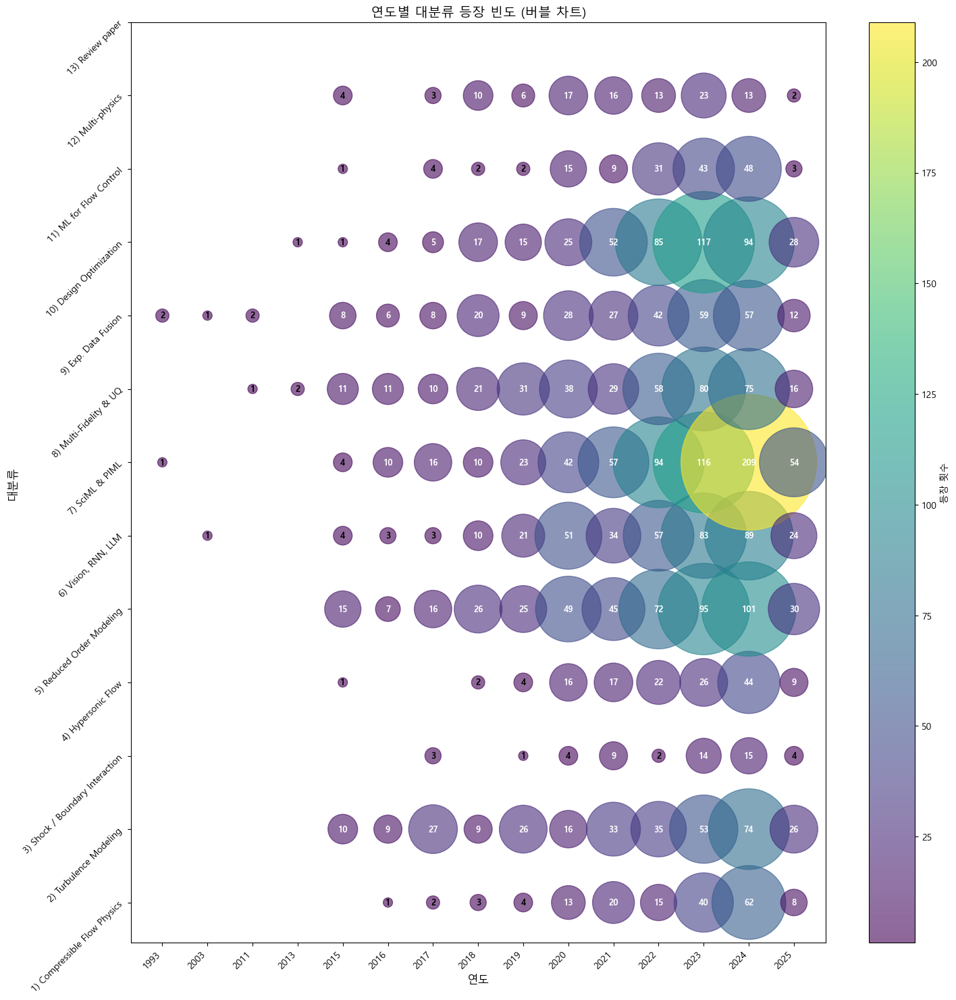

In [11]:
import json
import re
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker

# Windows용 한글 폰트 설정
plt.rcParams['font.family'] = 'Malgun Gothic'
plt.rcParams['axes.unicode_minus'] = False  # 마이너스 부호 깨짐 방지

# Load JSON
with open("analysis_results_3rd.json", "r", encoding="utf-8") as f:
    data = json.load(f)

# 대분류 레이블 (선택적 사용)
category_labels = {
    "1": "Compressible Flow Physics",
    "2": "Turbulence Modeling",
    "3": "Shock / Boundary Interaction",
    "4": "Hypersonic Flow",
    "5": "Reduced Order Modeling",
    "6": "Vision, RNN, LLM",
    "7": "SciML & PIML",
    "8": "Multi-Fidelity & UQ",
    "9": "Exp. Data Fusion",
    "10": "Design Optimization",
    "11": "ML for Flow Control",
    "12": "Multi-physics",
    "13": "Review paper"
}

# 데이터프레임 구성: (year, category) 리스트
rows = []
for entry in data:
    year = entry["year"]
    for c in entry["classification"]:
        match = re.match(r"(\d{1,2})-", c)
        if match:
            major = match.group(1)
            rows.append({"year": year, "category": major})

df = pd.DataFrame(rows)

# 등장 횟수 집계
count_df = df.groupby(["year", "category"]).size().reset_index(name="count")

# 숫자 정렬을 위해 category와 year 정렬
count_df["year"] = count_df["year"].astype(str)
#count_df["category"] = count_df["category"].astype(str)
#count_df["cat_label"] = count_df["category"].map(lambda c: f"{c}) {category_labels.get(c, '')}")

# 분류번호와 이름 합치기
count_df["category_num"] = count_df["category"].astype(int)  # 정렬용 숫자
count_df["cat_label"] = count_df["category"].map(lambda c: f"{c}) {category_labels.get(c, '')}")
# y축 순서 정의: category_num 오름차순
sorted_labels = [f"{k}) {category_labels[k]}" for k in sorted(category_labels.keys(), key=int)]
count_df["cat_label"] = pd.Categorical(count_df["cat_label"], categories=sorted_labels, ordered=True)

# 정렬 후 x좌표를 숫자로 매핑
count_df = count_df.sort_values(["year", "cat_label"])
count_df["ypos"] = count_df["cat_label"].cat.codes  # 0, 1, 2, ..., N 순서 인덱스

# 버블차트 그리기
plt.figure(figsize=(15, 15))
scatter = plt.scatter(
    y=count_df["ypos"],
    x=count_df["year"],
    s=count_df["count"] * 100,  # 버블 크기 (100배 스케일)
    alpha=0.6,
    c=count_df["count"],
    cmap="viridis"
)

# 텍스트 라벨 추가 
for i, row in count_df.iterrows():
    plt.text(
        row["year"],
        row["ypos"],
        str(row["count"]),
        ha='center',
        va='center',
        fontsize=9,
        color= "black" if row["count"] < 5 else "white",
        weight='bold'
    )

plt.ylabel("대분류", fontsize=12)
plt.xlabel("연도", fontsize=12)
plt.title("연도별 대분류 등장 빈도 (버블 차트)", fontsize=14)
plt.xticks(rotation=45, ha="right")
plt.yticks(ticks=range(len(sorted_labels)), labels=sorted_labels, rotation=45, ha="right")
cbar = plt.colorbar(scatter, label="등장 횟수")
cbar.ax.yaxis.set_major_locator(ticker.MaxNLocator(integer=True))
plt.tight_layout()
plt.show()


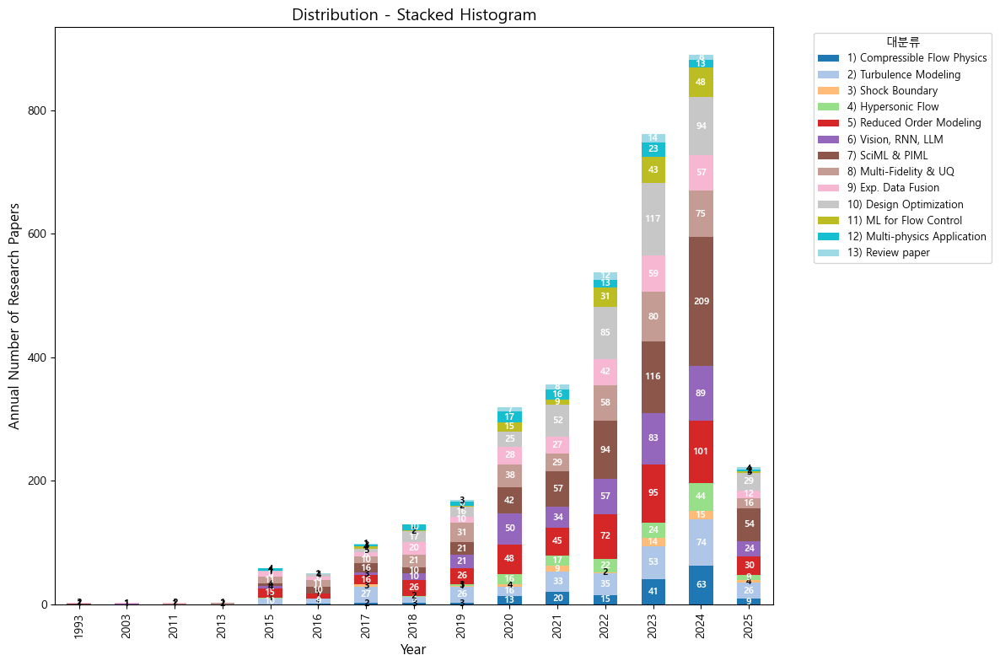

In [ ]:
import json
import re
import pandas as pd
import matplotlib.pyplot as plt

# Windows용 한글 폰트 설정
plt.rcParams['font.family'] = 'Malgun Gothic'
plt.rcParams['axes.unicode_minus'] = False  # 마이너스 부호 깨짐 방지

# Load JSON
with open("analysis_results_3rd.json", "r", encoding="utf-8") as f:
    data = json.load(f)

# 대분류 번호와 이름
category_labels = {
    "1": "Compressible Flow Physics",
    "2": "Turbulence Modeling",
    "3": "Shock Boundary",
    "4": "Hypersonic Flow",
    "5": "Reduced Order Modeling",
    "6": "Vision, RNN, LLM",
    "7": "SciML & PIML",
    "8": "Multi-Fidelity & UQ",
    "9": "Exp. Data Fusion",
    "10": "Design Optimization",
    "11": "ML for Flow Control",
    "12": "Multi-physics Application",
    "13": "Review paper"
}

def clean_year(raw_year):
    """문자열에서 숫자만 추출해 연도로 정제 (4자리만 유지)"""
    if not raw_year:
        return "Unknown"
    
    # 모든 숫자 추출
    digits = re.findall(r"\d", str(raw_year))
    cleaned = ''.join(digits)
    
    # 4자리만 허용
    return cleaned if len(cleaned) == 4 else "Unknown"

# 데이터 구성: (year, category)
rows = []
for entry in data:
    raw_year = entry.get("year", "")
    year = clean_year(raw_year)

    for c in entry.get("classification", []):
        match = re.match(r"^(\d{1,2})(?:-\d+)?\)$", c)  #  하이픈 유무 상관 없이 대분류 추출
        if match:
            major = match.group(1)
            rows.append({"year": year, "category": major})

df = pd.DataFrame(rows)

# 피벗 테이블 (연도별 분류번호 등장 횟수)
pivot = df.pivot_table(index="year", columns="category", aggfunc="size", fill_value=0)



# 분류번호 정렬: 숫자로 정렬, 그리고 category_labels에 정의된 번호만 필터링
valid_categories = [k for k in pivot.columns if k in category_labels]
sorted_columns = sorted(valid_categories, key=lambda x: int(x))
pivot = pivot[sorted_columns]

# 범례용 라벨: 번호 + 이름
pivot.columns = [f"{c}) {category_labels[c]}" for c in sorted_columns]

# 스택 바 차트 그리기
ax = pivot.plot(
    kind="bar",
    stacked=True,
    figsize=(12, 8),
    colormap="tab20"
)

# 각 세그먼트 위에 등장 횟수 텍스트 표시
for p in ax.patches:
    height = p.get_height()
    if height > 0:
        ax.text(
            x=p.get_x() + p.get_width() / 2,
            y=p.get_y() + height / 2,
            s=int(height),
            ha='center',
            va='center',
            fontsize=8,
            color='white' if height > 5 else 'black',
            weight='bold'
        )

# 연도별 총 등장 횟수
year_totals = pivot.sum(axis=1).to_dict()

# 연도 및 분류 라벨 리스트
years = list(pivot.index)
cols = list(pivot.columns)

for i, p in enumerate(ax.patches):
    height = p.get_height()
    if height > 0:
        # 🎯 패치 순서는 분류(컬럼) 중심으로 반복됨 → 정렬은 col/row 순
        col = i // len(years)   # 분류 인덱스
        row = i % len(years)    # 연도 인덱스

        year_label = years[row]
        col_label = cols[col]

        total = year_totals.get(year_label, 1)
        percent = height / total * 100
        label = f"{int(height)} ({percent:.1f}%)"

        '''ax.text(
            x=p.get_x() + p.get_width() / 2,
            y=p.get_y() + height / 2,
            s=label,
            ha='center',
            va='center',
            fontsize=8,
            color='white' if height > 5 else 'black',
            weight='bold'
            
        )'''
        
# 제목, 축 라벨
plt.title("Distribution - Stacked Histogram", fontsize=14)
plt.xlabel("Year", fontsize=12)
plt.ylabel("Annual Number of Research Papers", fontsize=12)  # 키워드 등장횟수(count)

# 범례 정렬 및 배치
handles, labels = ax.get_legend_handles_labels()
ax.legend(
    handles,
    labels,
    title="대분류",
    title_fontsize=10,
    fontsize=9,
    bbox_to_anchor=(1.05, 1),
    loc="upper left"
)

plt.tight_layout()
plt.show()

<Figure size 1200x600 with 0 Axes>

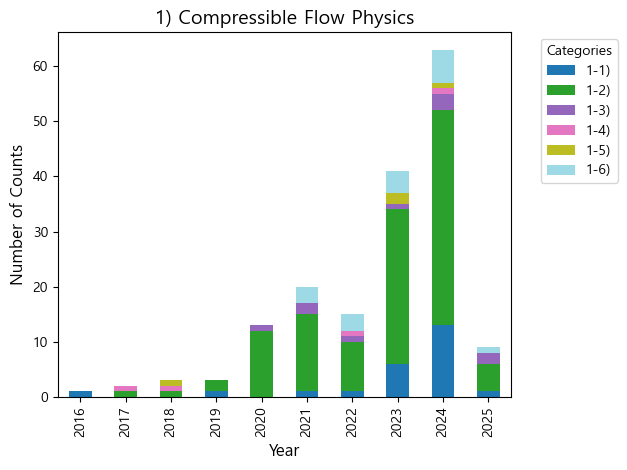

<Figure size 1200x600 with 0 Axes>

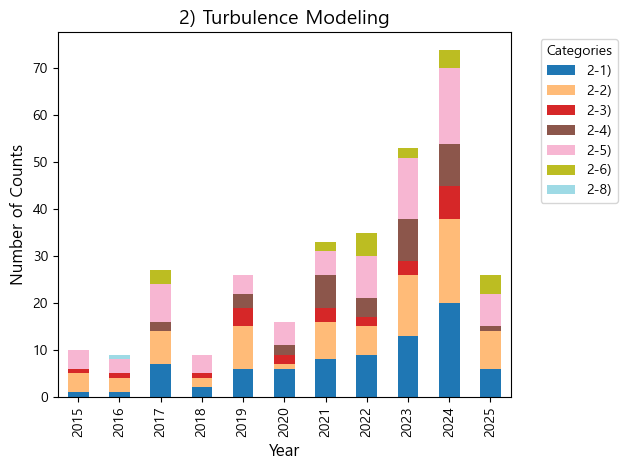

<Figure size 1200x600 with 0 Axes>

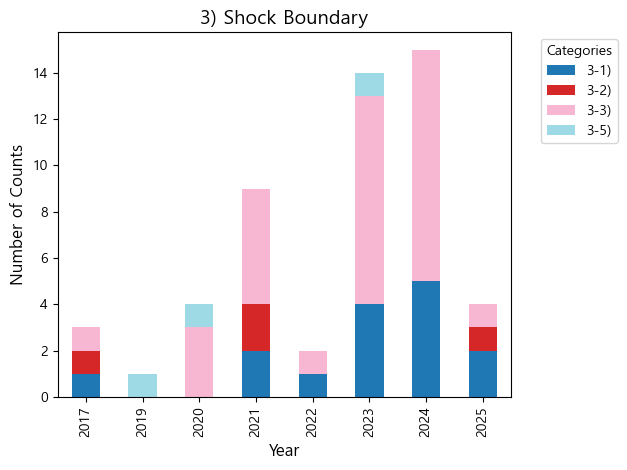

<Figure size 1200x600 with 0 Axes>

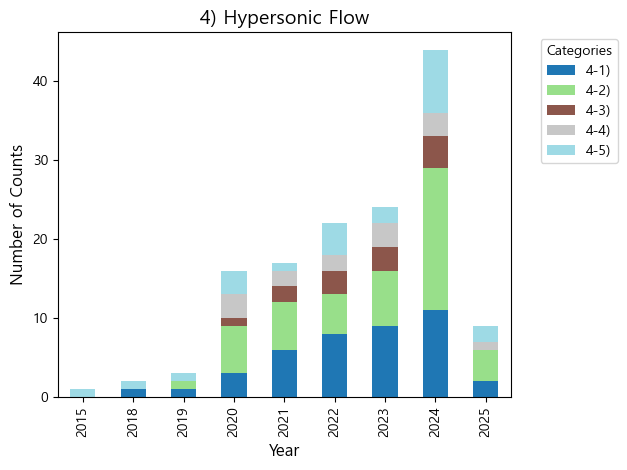

<Figure size 1200x600 with 0 Axes>

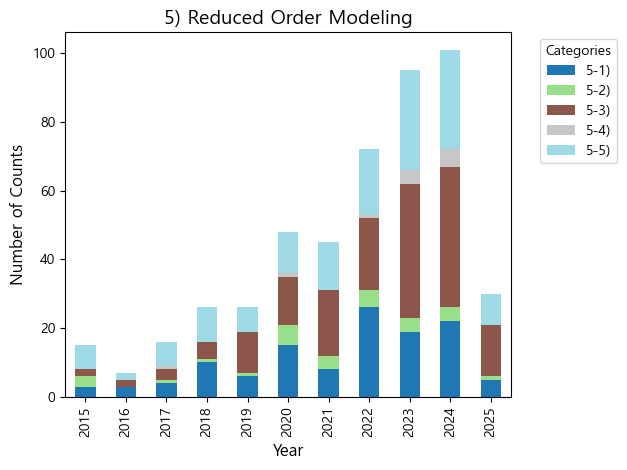

<Figure size 1200x600 with 0 Axes>

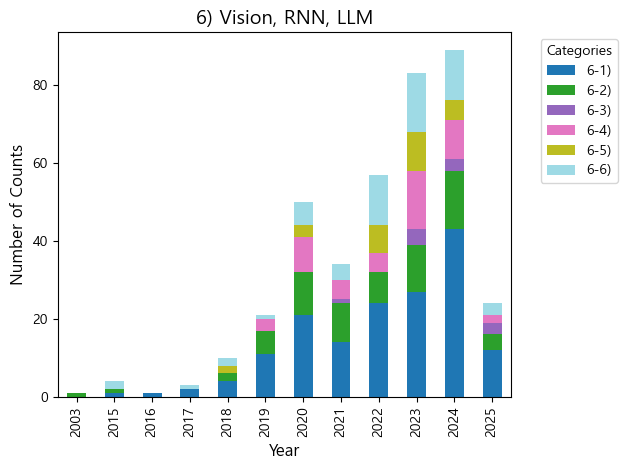

<Figure size 1200x600 with 0 Axes>

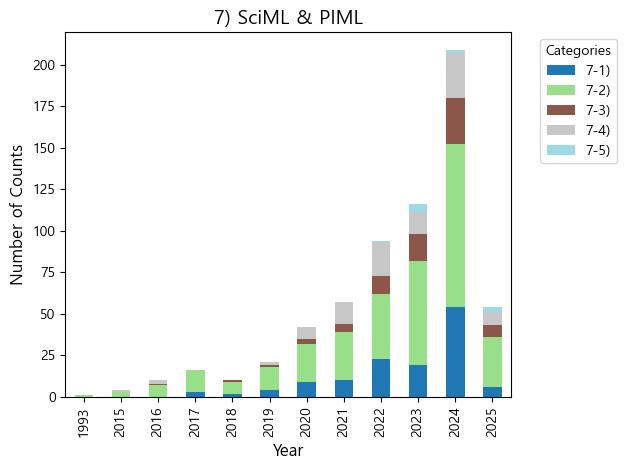

<Figure size 1200x600 with 0 Axes>

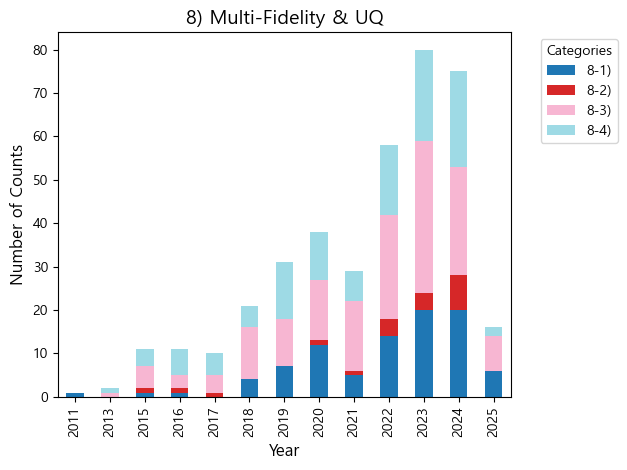

<Figure size 1200x600 with 0 Axes>

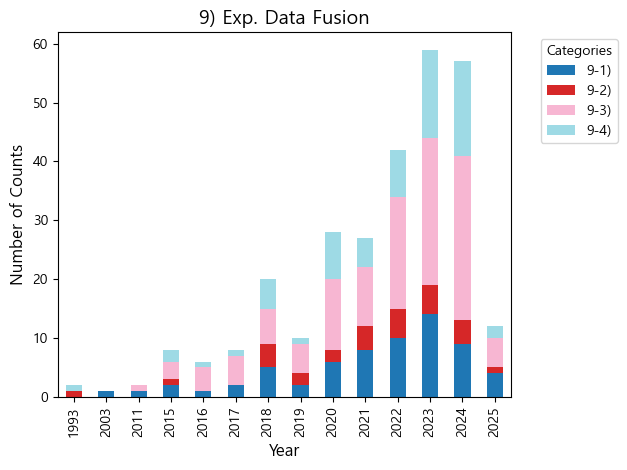

<Figure size 1200x600 with 0 Axes>

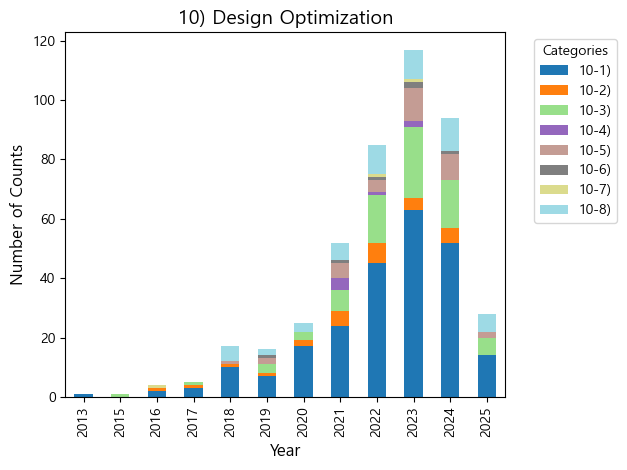

<Figure size 1200x600 with 0 Axes>

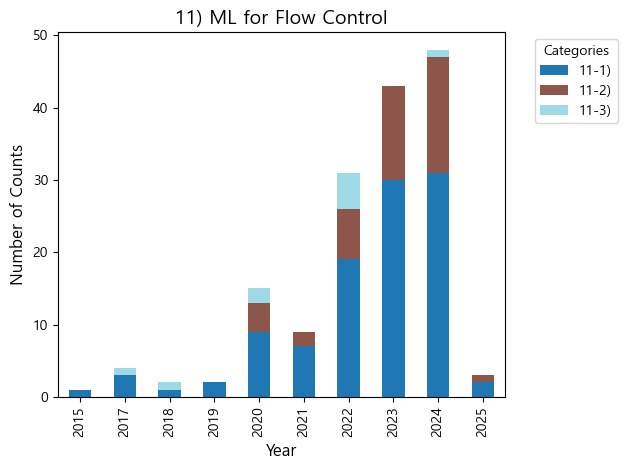

<Figure size 1200x600 with 0 Axes>

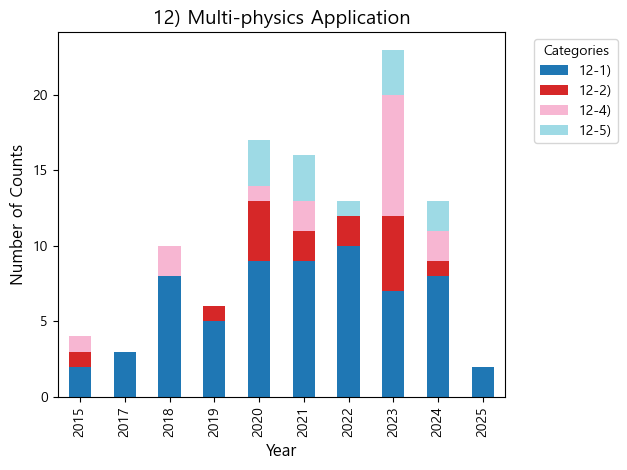

✅ Bar charts saved in: yearly_histograms_by_major_sub


In [127]:
import json
import re
import pandas as pd
import matplotlib.pyplot as plt
import os

# 한글 폰트 설정 (Windows 기준)
plt.rcParams['font.family'] = 'Malgun Gothic'
plt.rcParams['axes.unicode_minus'] = False

# Load JSON
with open("analysis_results_3rd.json", "r", encoding="utf-8") as f:
    data = json.load(f)

# 대분류 번호와 이름 (13 제외)
category_labels = {
    "1": "Compressible Flow Physics",
    "2": "Turbulence Modeling",
    "3": "Shock Boundary",
    "4": "Hypersonic Flow",
    "5": "Reduced Order Modeling",
    "6": "Vision, RNN, LLM",
    "7": "SciML & PIML",
    "8": "Multi-Fidelity & UQ",
    "9": "Exp. Data Fusion",
    "10": "Design Optimization",
    "11": "ML for Flow Control",
    "12": "Multi-physics Application"
}

# 연도 정제 함수
def clean_year(raw_year):
    digits = re.findall(r"\d", str(raw_year))
    cleaned = ''.join(digits)
    return cleaned if len(cleaned) == 4 else "Unknown"

# 저장 경로
output_dir = "yearly_histograms_by_major_sub"
os.makedirs(output_dir, exist_ok=True)

# 대분류별 소분류 연도별 추이
for major in sorted(category_labels.keys(), key=int):
    rows = []

    for entry in data:
        raw_year = entry.get("year", "")
        year = clean_year(raw_year)

        for c in entry.get("classification", []):
            match = re.match(rf"^{major}-(\d+)\)$", c)
            if match:
                sub = match.group(1)
                subcat = f"{major}-{sub})"
                rows.append({"year": year, "subcategory": subcat})

    if not rows:
        continue

    df = pd.DataFrame(rows)
    pivot = df.pivot_table(index="year", columns="subcategory", aggfunc="size", fill_value=0)

    plt.figure(figsize=(12, 6))
    pivot.plot(kind="bar", stacked=True, colormap="tab20", legend=True)
    plt.title(f"{major}) {category_labels[major]}", fontsize=14)
    plt.xlabel("Year", fontsize=12)
    plt.ylabel("Number of Counts", fontsize=12)
    plt.legend(title="Categories", bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()
    plt.savefig(f"{output_dir}/major_{major}_yearly_sub_histogram.png")
    plt.show()

print(f"✅ Bar charts saved in: {output_dir}")

In [17]:
import json
import re
from collections import defaultdict, Counter
import plotly.graph_objects as go
import plotly.express as px

# JSON 파일 로드
with open("analysis_results_3rd.json", "r", encoding="utf-8") as f:
    papers = json.load(f)

# 번호별 설명
category_description = {
    "1": "Compressible Flow Physics",
    "2": "Turbulence Modeling",
    "3": "Shock Boundary",
    "4": "Hypersonic Flow",
    "5": "Reduced Order Modeling",
    "6": "Vision, RNN, LLM",
    "7": "SciML & PIML",
    "8": "Multi-Fidelity & UQ",
    "9": "Exp. Data Fusion",
    "10": "Design Optimization",
    "11": "ML for Flow Control",
    "12": "Multi-physics Application"
}

physics_labels = {"1", "2", "3", "4"}
method_labels = {"5", "6", "7", "8", "9"}
application_labels = {"10", "11", "12"}

# 분류번호 추출 함수
def extract_major_codes(classifications):
    majors = []
    for c in classifications:
        match = re.match(r"(\d+)-", c)
        if match:
            majors.append(match.group(1))
    return majors

# 링크 수집
def collect_links(papers, source_labels, target_labels):
    links = []
    for paper in papers:
        majors = extract_major_codes(paper.get("classification", []))
        sources = [m for m in majors if m in source_labels]
        targets = [m for m in majors if m in target_labels]
        for s in sources:
            for t in targets:
                links.append((s, t))
    return links

# 링크 데이터 생성
def build_sankey_data(links):
    counter = Counter(links)
    nodes = sorted(list(set([k[0] for k in counter] + [k[1] for k in counter])), key=lambda x: int(x))
    node_indices = {label: idx for idx, label in enumerate(nodes)}
    source = []
    target = []
    value = []
    for (src, tgt), count in counter.items():
        source.append(node_indices[src])
        target.append(node_indices[tgt])
        value.append(count)
    return nodes, source, target, value, counter

# Color palette 설정
def generate_color_list(n):
    colors = px.colors.qualitative.Light24
    while len(colors) < n:
        colors += colors
    return colors[:n]

# Sankey Diagram 생성
def plot_sankey(nodes, source, target, value, counter, title):
    nodes_sorted = sorted(nodes, key=lambda x: int(x))
    node_indices = {label: idx for idx, label in enumerate(nodes_sorted)}
    node_labels = [f"{num})" for num in nodes]
    node_colors = generate_color_list(len(nodes))
    
    fig = go.Figure()
    
    fig.add_trace(go.Sankey(
        arrangement="snap",
        orientation="v",
        node=dict(
            pad=15,
            thickness=20,
            line=dict(color="black", width=0.5),
            label=node_labels,
            color=node_colors
        ),
        link=dict(
            source=source,  # 수정: 그냥 source 사용
            target=target,  # 수정: 그냥 target 사용
            value=value,
            color="rgba(150,150,250,0.4)"
        )
    ))

    # 범례 텍스트 생성
    legend_text = "<br>".join([
        f"<span style='color:black' >{num}) {category_description.get(num, '')}</span>"
        for num in nodes_sorted if num in category_description
    ])



    fig.update_layout(
        title_text=title,
        font_size=12,
        height=1000,
        margin=dict(l=0, r=300, t=50, b=0)
    )
    fig.show()

# Physics -> Method
physics_links = collect_links(papers, physics_labels, method_labels)
phy_nodes, phy_source, phy_target, phy_value, phy_counter = build_sankey_data(physics_links)
plot_sankey(phy_nodes, phy_source, phy_target, phy_value, phy_counter, "Physics (1-4) → Method (5-9) Mapping (Plotly Sankey)")

# Application -> Method
application_links = collect_links(papers, application_labels, method_labels)
app_nodes, app_source, app_target, app_value, app_counter = build_sankey_data(application_links)
plot_sankey(app_nodes, app_source, app_target, app_value, app_counter, "Application (10-12) → Method (5-9) Mapping (Plotly Sankey)")


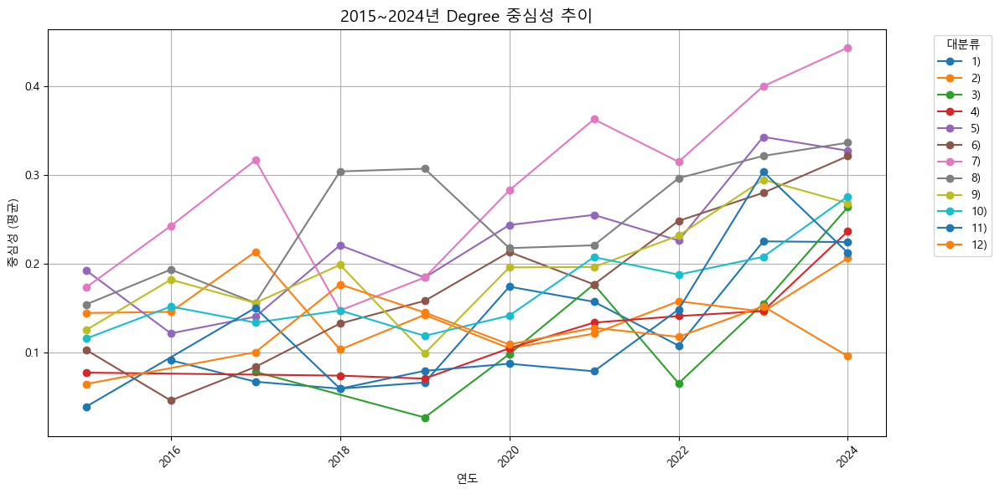

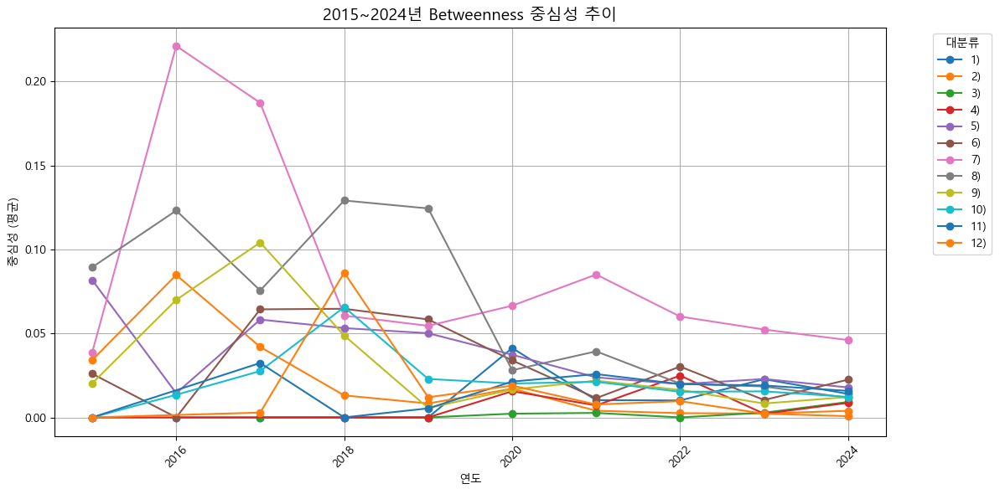

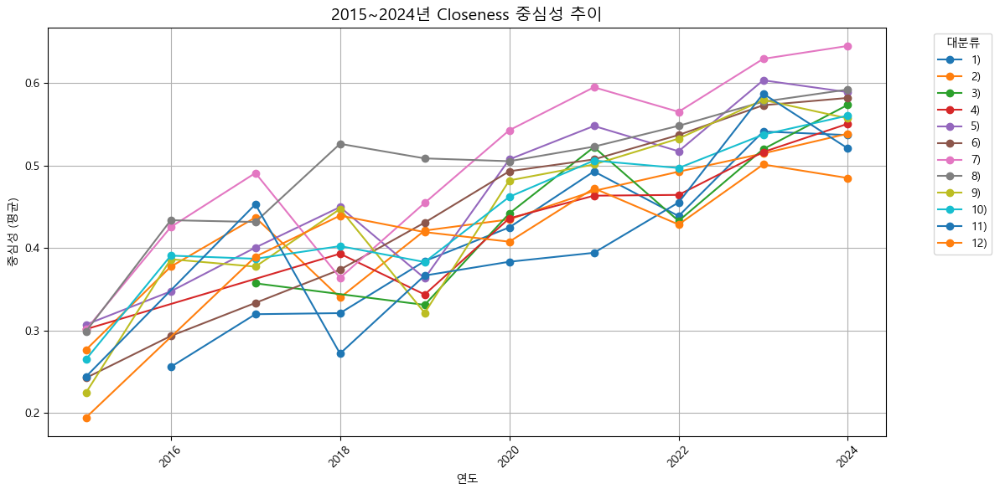

In [128]:
import json
import re
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
from collections import defaultdict

# 중심성 분석 함수
def compute_centrality_trend(data, metric_func):
    yearly_edges = defaultdict(list)

    for entry in data:
        year_match = re.match(r"\(?\s*(\d{4})\s*\)?", entry.get("year", ""))
        if not year_match:
            continue
        year = year_match.group(1)
        if not ("2015" <= year <= "2024"):
            continue

        subs = [
            re.match(r"(\d{1,2}-\d{1,2})\)", c.strip()).group(0)
            for c in entry.get("classification", [])
            if re.match(r"(\d{1,2}-\d{1,2})\)", c.strip())
        ]
        for i in range(len(subs)):
            for j in range(i + 1, len(subs)):
                yearly_edges[year].append((subs[i], subs[j]))

    records = []
    for year in sorted(yearly_edges.keys()):
        G = nx.Graph()
        G.add_edges_from(yearly_edges[year])
        centrality = metric_func(G)
        for node, score in centrality.items():
            major = node.split("-")[0]
            records.append({"연도": year, "대분류": major, "중심성": score})
    return pd.DataFrame(records)

# 중심성 계산
def plot_metric(df, title):
    # 평균값 계산
    summary = df.groupby(["연도", "대분류"]).agg({"중심성": "mean"}).reset_index()
    summary["연도"] = summary["연도"].astype(int)
    summary["대분류"] = summary["대분류"].astype(int)
    summary = summary.sort_values(["연도", "대분류"])
    
    # 그래프
    plt.figure(figsize=(12, 6))
    for cat in sorted(summary["대분류"].unique()):
        subset = summary[summary["대분류"] == cat]
        plt.plot(subset["연도"], subset["중심성"], label=f"{cat})", marker="o")
    plt.title(title, fontsize=14)
    plt.xlabel("연도")
    plt.ylabel("중심성 (평균)")
    plt.legend(title="대분류", bbox_to_anchor=(1.05, 1), loc="upper left")
    plt.xticks(rotation=45)
    plt.grid(True)
    plt.tight_layout()
    plt.show()

# JSON 데이터 로드
with open("analysis_results_3rd.json", "r", encoding="utf-8") as f:
    data = json.load(f)

# 중심성별 시각화
deg_df = compute_centrality_trend(data, nx.degree_centrality)
plot_metric(deg_df, "2015~2024년 Degree 중심성 추이")

btw_df = compute_centrality_trend(data, nx.betweenness_centrality)
plot_metric(btw_df, "2015~2024년 Betweenness 중심성 추이")

cls_df = compute_centrality_trend(data, nx.closeness_centrality)
plot_metric(cls_df, "2015~2024년 Closeness 중심성 추이")


C:\Users\KISTI\AppData\Local\Temp\ipykernel_31172\1025248503.py:37: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



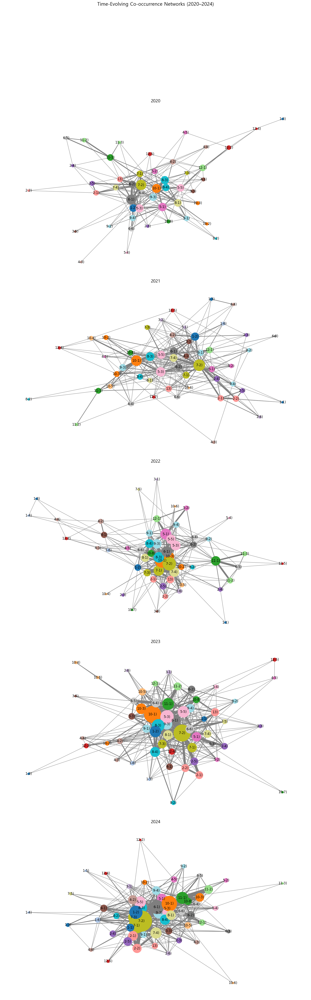

In [119]:
import json
import networkx as nx
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from collections import defaultdict, Counter

# === Load JSON File ===
with open("analysis_results_3rd.json", "r", encoding="utf-8") as f:
    papers = json.load(f)

# === Prepare Data ===
year_range = range(2020, 2025)
yearly_edges = defaultdict(Counter)
node_counts_by_year = defaultdict(Counter)

for paper in papers:
    try:
        year = int(paper.get("year", "0"))
        if year in year_range:
            classifications = list(set(paper.get("classification", [])))
            for i in range(len(classifications)):
                node_counts_by_year[year][classifications[i]] += 1
                for j in range(i + 1, len(classifications)):
                    a, b = sorted([classifications[i], classifications[j]])
                    yearly_edges[year][(a, b)] += 1
    except:
        continue

# === Consistent Node Color Assignment ===
all_nodes = set()
for year_data in node_counts_by_year.values():
    all_nodes.update(year_data.keys())
all_nodes = sorted(list(all_nodes))

node_color_map = {node: idx for idx, node in enumerate(all_nodes)}
cmap = cm.get_cmap("tab20", len(all_nodes))
color_list = [mcolors.to_hex(cmap(i)) for i in range(len(all_nodes))]
node_color_dict = {node: color_list[i] for node, i in node_color_map.items()}

# === Draw Time-Evolving Graphs ===
fig, axes = plt.subplots(5, 1, figsize=(16, 52))

for idx, year in enumerate(year_range):
    G = nx.Graph()
    edge_weights = yearly_edges[year]
    G.add_edges_from([(a, b, {'weight': w}) for (a, b), w in edge_weights.items()])
    
    pos = nx.spring_layout(G, seed=42)
    node_sizes = [node_counts_by_year[year].get(n, 1) * 60 for n in G.nodes()]
    node_colors = [node_color_dict[n] for n in G.nodes()]
    edge_widths = [G[u][v]['weight'] * 1.0 for u, v in G.edges()]
    
    nx.draw(G, pos, ax=axes[idx],
            with_labels=True,
            node_color=node_colors,
            edge_color='gray',
            node_size=node_sizes,
            width=edge_widths,
            font_size=12)
    axes[idx].set_title(f"{year}", fontsize=16)

plt.suptitle("Time-Evolving Co-occurrence Networks (2020–2024)", fontsize=18)
plt.tight_layout()
plt.subplots_adjust(top=0.88)
plt.show()
